In [ ]:
!pip install langchain langchain-community

In [ ]:
!pip install PyMuPDF
!pip install python-docx
!pip install python-pptx
!pip install markdown
!pip install jq
!pip install pypdf

In [ ]:
!pip install pytesseract

In [ ]:
!apt-get install -y tesseract-ocr poppler-utils

In [ ]:
!pip install openparse[ml]

In [ ]:
!pip install pdfplumber

In [ ]:
!pip install unstructured "unstructured[pdf]"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 24.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.4/149.4 kB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 11.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 62.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.4/48.4 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.5/112.5 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 586.9/586.9 kB 37.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 514.6/514.6 kB 37.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 63.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 52.7 MB/s eta 0:

In [ ]:
import os
import fitz
import re
import json
import pandas as pd
import difflib
from typing import Dict, List, Any

## Test with PDFPlumberLoader

In [ ]:
from langchain_community.document_loaders import PDFPlumberLoader

In [ ]:
loader = PDFPlumberLoader("table_sample.pdf")
plumber_check = loader.load()

In [ ]:
print(plumber_check[5].page_content)

ENGINE REPAIR AND ADJUSTMENT PARAMETERS
D. VALVE INESPECTION
1. Check valve leakages by pouring gasoline on
valve head. Gasoline must not seep past valve
seat.
2. Valves with burnt heads, excessive scoring and
wear on stem should be replaced.
3. Check valve seat run out with respect to valve
stem. If it exceeds specified limit replace valve.
No attempt should be made to straighten bent
valves.
7. Check for leakages through valve seat by
pouring gasoline on valve head. Gasoline must
not seep past valve seat.
F. VALVE SEAT INSERTS REMOVAL
4. If valve found defective, replace the valve.
1. For removing valve seat inserts from cylinder
NOTE
head use suitable boring machine. Bore old
E. VALVE SEAT
• Valve seat must be absolutely faultless and insert thin (About 0.5 mm thickness) and then
without any chatter marks pry it out.
2. Alternatively use a suitable turning tool to cut
1. Check valve seat height with respect to cylinder an annular groove into valve seat insert and
head mating surface

## Langchain - Unstructured strategy: fast

In [ ]:
from langchain_community.document_loaders import UnstructuredPDFLoader

In [ ]:
unstructrured_loader = UnstructuredPDFLoader("table_sample.pdf",
        strategy="fast",
        mode="elements",
        chunking_strategy="basic",
)

In [ ]:
our_check = unstructrured_loader.load()

In [ ]:
len(our_check)

51

In [ ]:
our_check[5].page_content

'Maximum run out of valve seat with respect to valve stem\n\n0.03\n\nDistance of valve head from cylinder head mating surface with crankcase ‘E’\n\n0.524±0.080/0.085\n\nEXHAUST\n\n29.7 + 0.1\n\n450 + 15’\n\n6.953+0.007/-0.008\n\n7.029+0.007/-0.008\n\n7.080+0.007/-0.008\n\n7.207+0.007/-0.008\n\n0.1\n\n23.9±0.10\n\n2.05 + 0.08\n\n0.03\n\n0.5±0.13/0.08\n\n1\n\nENGINE REPAIR AND ADJUSTMENT PARAMETERS\n\nVALVE DIMENSIONS (mm)\n\nINLET\n\nValve seat angle ‘H’\n\n60°\n\n(Normal)\n\n34.000 +0.080/+0.065'

In [ ]:
our_check[3].metadata

{'source': 'table_sample.pdf',
 'coordinates': {'points': ((233.52, 65.91842099999997),
   (233.52, 86.52167099999997),
   (389.35910958899996, 86.52167099999997),
   (389.35910958899996, 65.91842099999997)),
  'system': 'PixelSpace',
  'layout_width': 612.0,
  'layout_height': 792.0},
 'filename': 'table_sample.pdf',
 'languages': ['eng'],
 'last_modified': '2024-12-17T20:42:24',
 'page_number': 2,
 'filetype': 'application/pdf',
 'category': 'Title',
 'element_id': '3460cadf70c317707c88f23594e62107'}

In [ ]:
extraction_params = {
        "fast": {
            "hi_res": False,
            "ocr_enabled": False,
            "strategy": "fast",
            "infer_table_structure": False,
            "max_partition": 1000
        },
        "precise": {
            "hi_res": True,
            "strategy": "hi_res",
            "ocr_enabled": False,
            "infer_table_structure": True,
            "max_partition": 2000
        }
}

def extract_metadata(element):
    return {
        "page_number": element.get("page_number", None),
        "source": element.get("source", None),
        "bbox": element.get("bbox", None),
        "type": element.get("type", None),
        "confidence": element.get("confidence", None)
    }

params = extraction_params["precise"]
elements = partition_pdf(
            filename="tarunjain_redhenlab_gsoc24.pdf",
            **params
        )

yolox_l0.05.onnx:   0%|          | 0.00/217M [00:00<?, ?B/s]

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

config.json:   0%|          | 0.00/1.47k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/115M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/46.8M [00:00<?, ?B/s]

In [ ]:
from unstructured.partition.pdf import partition_pdf

In [ ]:
from unstructured.staging.base import dict_to_elements, elements_to_json
from unstructured.chunking.basic import chunk_elements
from unstructured.chunking.title import chunk_by_title

In [ ]:
import json

In [ ]:
element_dict = [el.to_dict() for el in elements]

In [ ]:
len(element_dict)

224

In [ ]:
chunks = chunk_by_title(
    elements,
    combine_text_under_n_chars=100,
    max_characters=2000,
)

In [ ]:
chunked = [el.to_dict() for el in chunks]

In [ ]:
chunked[3]

{'type': 'CompositeElement',
 'element_id': '978ba6ac-0cf4-43d4-a50c-0f9f3d076c66',
 'text': 'Education\n\nUniversity: Cambridge Institute of Technology(2019-2023): Graduated in August 2023 ● Degree: Bachelor of Engineering ● Field of study: Electronics and Communication Engineering\n\n3) Potential Mentor(s)\n\nPrimary Mentor: Sridhar Vanga ● Team: Saby Ghosal and Karan\n\n4) My Contribution in Open Source LLMs and Fine Tuning',
 'metadata': {'filename': 'tarunjain_redhenlab_gsoc24.pdf',
  'filetype': 'application/pdf',
  'languages': ['eng'],
  'last_modified': '2024-12-18T11:23:55',
  'page_number': 2,
  'orig_elements': 'eJzlVk1v2zgQ/SuETg2QuCQlSqJv/UiLogkaIO5esoExJEcyC4k0KKqtUex/X0pWgGzhBdpDDkVOwpt5Iw35ho+6+5Fhhz26uLUmW5OsETwvta4g50oDgiw1VMA4VmUpaAHZOcl6jGAgQuL/yLT3wVgHEYcZd3DwY9zu0La7mCJ1wVPJEv1mTdyloJBlCu69dXGqurur+IqeE5aXq/r+nDzAoj5CxsWqOIFnegpkw2GI2E/939jv2N3uQWP2T0o0tkMHPU6pCGF0X8C6bUCzQ9eB2raD17xY7U2TLex42M9s2O87qyFa714u6Q5cO0I7L/QuQ9dm93N0iNveG9tYnLeQU15cMH7B6g1ja56vhZiq96ly

In [ ]:
type(chunked)

list

In [ ]:
from langchain_text_splitters import MarkdownTextSplitter
from langchain_text_splitters import RecursiveCharacterTextSplitter
from langchain_text_splitters import Language
from langchain_core.embeddings import Embeddings
import requests
from typing import List

In [ ]:
from langchain_core.documents import Document

documents = []
for element in elements:
    metadata = element.metadata.to_dict()
    documents.append(Document(page_content=element.text, metadata=metadata))

In [ ]:
splitter = RecursiveCharacterTextSplitter.from_language(
    language=Language.MARKDOWN,chunk_size=2000,chunk_overlap=100
)

In [ ]:
len(documents)

224

In [ ]:
chunks = splitter.split_documents(documents)

In [ ]:
len(chunks)

223

In [ ]:
from langchain_text_splitters import MarkdownTextSplitter
from langchain_text_splitters import Language

In [ ]:
md_splitter = MarkdownTextSplitter()

In [ ]:
md_docs = md_splitter.split_documents(our_check)

In [ ]:
md_docs[1].page_content

'AND'

In [ ]:
md_docs[0].metadata

{'source': 'table_sample.pdf',
 'coordinates': {'points': ((196.68, 265.435785),
   (196.68, 299.212035),
   (422.07739408874994, 299.212035),
   (422.07739408874994, 265.435785)),
  'system': 'PixelSpace',
  'layout_width': 612.0,
  'layout_height': 792.0},
 'filename': 'table_sample.pdf',
 'languages': ['eng'],
 'last_modified': '2024-12-17T20:42:24',
 'page_number': 1,
 'filetype': 'application/pdf',
 'category': 'Title',
 'element_id': 'b972ecfc24a9960a981bb68fc18fb015'}

In [ ]:
markdown_splitter = MarkdownTextSplitter(chunk_size=200, chunk_overlap=0)
docs = markdown_splitter.create_documents([our_check[1].page_content])

for doc in docs:
    print(doc.page_content)

AND


In [ ]:
for data in our_check:
  print(data.page_content)
  print("/n")

In [ ]:
len(our_check)

561

In [ ]:
print(our_check[40].page_content)

23.9±0.10


In [ ]:
unstructrured_loader1 = UnstructuredPDFLoader("table_sample.pdf",
        strategy="hi_res",
    hi_res_model_name="yolox",
    pdf_infer_table_structure=True,
    skip_infer_table_types=[]
)

In [ ]:
our_check2 = unstructrured_loader1.load()

yolox_l0.05.onnx:   0%|          | 0.00/217M [00:00<?, ?B/s]

## Open Parse

A. Valve and Valve Seat Dimensions……………………………………...(1-2) 
B. Valve Seat Insert and Bore Diameter in Cylinder Head……...(3) 
C. Valve Guide Bore Diameter in Cylinder Head…………………….(3) 
D. Valve Inspection…………………………………………………………….….(4) 
E. Valve Seat …………………………………………………………………….…..(4) 
F. Valve Seat Inserts Removal.…………………………………………….….(4) 
G. Crankcase………………………………………………………………….….……(5) 
H. Piston and Piston Bore Sizes……………………………………....……..(6) 
I. Piston Rings………………………………………………………….……….……(7) 
J. Repair Sizes for Piston Rings…………………………………….….……..(7) 
K. Piston and Piston Ring Inspection……………………………………….(8) 
L. Connecting Rod…………………………………………………………………..(9) 
M. Connecting Rod Inspection…………………………………….…………..(10-12) 
N. Cylinder Head……………………………………………………………..……..(13) 
O. Cylinder Block Inspection………………………………………………...…(13-15) 
P. Cylinder Bore…………………………………………………………..…..…….(15) 
Q. Cylinder Head Gasket Selection…………………………………....……(16) 
R. Crankshaft………………………………………………………………....………(16) 
S. Crankshaft Inspection………………………………………………..…..…..(17) 
T. Assembly Clearances………………………………………………..…………(18) 

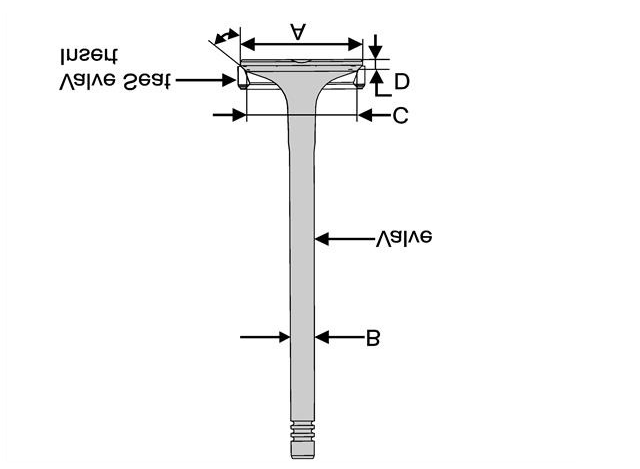

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**A. VALVE AND VALVE SEAT DIMENSIONS**

**VALVE DIMENSIONS (mm)**

**INLET**

**EXHAUST**

Valve head diameter ‘A’ 

33.0 + 0.1 

29.7 + 0.1 

Valve seat angle 

600 + 15’ 

450 + 15’ 

Standard Size 

6.963+0.007/-0.008 

6.953+0.007/-0.008 

Ist Oversize 

7.039+0.007/-0.008 

7.029+0.007/-0.008 

Valve stem diameter ‘B’ 

IInd Oversize 

7.090+0.007/-0.008 

7.080+0.007/-0.008 

IIIrd Oversize 

7.217+0.007/-0.008 

7.207+0.007/-0.008 

Maximum run out of valve face with respect to valve stem 

0.1 

0.1 

Valve seat diameter. ‘C’ 

27.4±0.10 

23.9±0.10 

Valve seat distance from valve face ‘D’ 

1.98 + 0.08 

2.05 + 0.08 

Maximum run out of valve seat with respect to valve stem 

0.03 

0.03 

0.524±0.080/0.085 

0.5±0.13/0.08 

Distance of valve head from cylinder head mating surface with 
crankcase ‘E’ 

1 

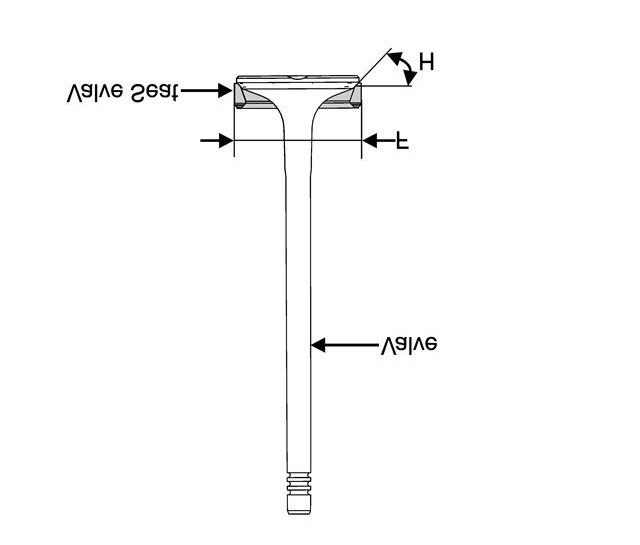

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**VALVE DIMENSIONS (mm)**

**INLET**

**EXHAUST**

Valve seat angle ‘H’ 

60° 

45° 

(Normal) 

(Normal) 

34.000 +0.080/+0.065 

31.1+0.080/+0.065 

Valve seat Insert diameter “F” in cylinder head 

(Normal 1) 

(Normal 1) 

34.3 +0.080/+0.065 

31.3 +0.080/+0.065 

0.035 

0.035 

Maximum run out of valve seat in cylinder head with 
respect to valve guide axis (mm) 

2 

**VALVE SEAT**
**INSERT BORE**
**DIAMETER IN CYLINDER HEAD**

**VALVE SEAT INSERT OUTSIDE**
**DIAMETER (mm)**

**SIZE**

**INLET**

34 +0.021 

**NORMAL**

34.3 +0.021 

**NORMAL 1**

**OUTLET**

31.1 +0.021 

**NORMAL**

31.3 +0.021 

**NORMAL 1**

**C.**

**VALVE GUIDE BORE DIAMETER IN CYLINDER HEAD**

**INLET VALVE GUIDE BORE**
**DIAMETER IN CYLINDER HEAD**
**(mm)**

**EXHAUST VALVE GUIDE BORE**
**DIAMETER IN CYLINDER HEAD**
**(mm)**

6.991 +0.0015 

6.991 +0.0015 

7.067 +0.015 

7.118 +0.015 

7.245 +0.015 

**VALVE STEM**
**RECEIVING BORE SIZE**

**STANDARD SIZE**

7.067 +0.015 

**IST OVERSIZE**

7.118 +0.015 

**IIND OVERSIZE**

7.245 +0.015 

**IIIRD OVERSIZE**

3 

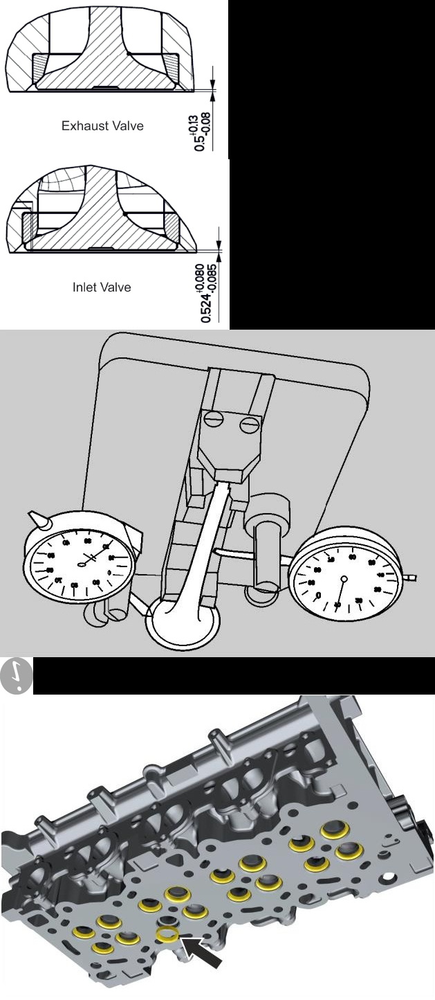

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**D. VALVE INESPECTION**

1. Check valve leakages by pouring gasoline on 

valve head. Gasoline must not seep past valve 
seat. 

2. Valves with burnt heads, excessive scoring and 

wear on stem should be replaced. 

3. Check valve seat run out with respect to valve 
stem. If it exceeds specified limit replace valve. 
No attempt should be made to straighten bent 
valves. 

7. 

Check for leakages through valve seat by 
pouring gasoline on valve head. Gasoline must 
not seep past valve seat. 

4. 

If valve found defective, replace the valve. 
**NOTE**

**E. VALVE SEAT**
• 

**F. VALVE SEAT INSERTS REMOVAL**
1. For removing valve seat inserts from cylinder 
head use suitable boring machine. Bore old 
insert thin (About 0.5 mm thickness) and then 
pry it out. 

Valve seat must be absolutely faultless and 
without any chatter marks 

1. Check valve seat height with respect to cylinder 
head mating surface. Replace valve seat 
inserts if they are worn out beyond specified 
limit. 

2. Cut exhaust valve seat insert with 45° and 
Intake valve seat insert with 60° cutter. 

2. Alternatively use a suitable turning tool to cut 
an annular groove into valve seat insert and 
then pull it out with a suitable puller. In order to 
avoid damaging machined cylinder head 
mating surface with crank case, place any soft 
protective sheet metal under supports of puller. 
3. Measure valve seat insert bore diameter in 

4. 

cylinder head. 
If boring and prying is done carefully without 
damaging valve seat insert bore in cylinder 
head, fitment of an oversize valve seat insert 
will not be necessary. 

5. Re-machined valve seat insert bore in cylinder 
head must be exactly at right angle to cylinder 
head mating surface with crank case. 

6. All specified dimensions should be strictly 
maintained to ensure proper interference of 
valve seat insert in its bore. 

7. Clean valve seat insert and its bore in cylinder 

head thoroughly. 

3. 

**VALVE SEAT INSERTS FITMENT**
1. Place valve seat insert in the mixture of 
Methanol and dry ice for about 20-30 minutes 
to bring temperature down to -150ºC. 

2. Heat cylinder head to approximately 80ºC in hot 

If necessary lap the valve seats to a smooth 
and even finish by using suitable hand pump 
grinder or a lapping paste and valve itself. 
4. Smear valve seat with carbon blue. Install valve 
in guide and turn it slowly under axial pressure. 
5. Contact line on valve seat must be around 

water bath. 

entire circumference at equal width. 

3. 

6. Distance between narrow diameters of valve 
face to contact line should be minimum 0.5 mm. 

Install valve seat insert in the cylinder head 
bore quickly by light hammering 
4. Machine valve seat in cylinder head. 

4 

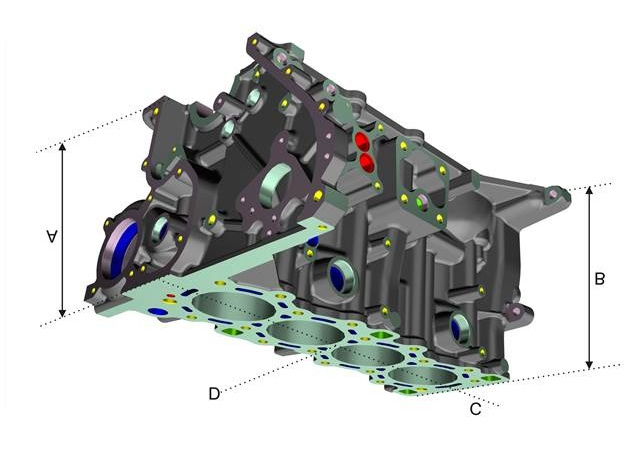

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**G. CRANKCASE**

Height of crankcase (Dimensions A and B) 

276.8 ± 0.05 mm 

Maximum permissible unevenness of cylinder block 

Lengthwise ‘c’ 

0.05 

mating surface with cylinder head 100 x 100 mm 

Crosswise ‘D’ 

0.025 

0.1 

Maximum permissible out off parallelism between cylinder block top and bottom 
machined surface 

0.04 

Maximum permissible shift in perpendicularity of cylinder bore from Crank shaft axis 
when checked at 200mm from crank shaft centre line. 

Maximum permissible circularity 

0.01 

Ovality of cylinder bore (Cylindricity) 

0.01 

Straightness 

0.01 

Cylinder offset 

5± 0.05 mm 

5 

**Stage**

**Grade**

**Cylinder bore diameter mm**

**Piston stamped diameter mm (Gallery**
**Cooled Piston)**

A 

100.000 - 100.010 

99.89 

B 

100.011 - 100.020 

99.901 

C 

100.021 - 100.030 

99.911 

A 

100.200 - 100.210 

100.09 

B 

100.211 - 100.220 

100.101 

C 

100.221 - 100.230 

100.111 

A 

100.400 - 100.410 

100.29 

B 

100.411 - 100.420 

100.301 

C 

100.421 - 100.430 

100.311 

A 

100.600 - 100.610 

100.49 

B 

100.611 - 100.620 

100.501 

C 

100.621 - 100.630 

100.511 

Piston to bore clearance(mm) 

0.103 - 0.127 

Weight variation in each set of 4 piston to be within 5 gms 

**Rings**

**Type of ring**

**Butt clearance in**
**cylinder bore (mm)**

1st Compression Ring 

3 

- 

0.25 - 0.4 

2nd Compression Ring 

2.5 -0.005/-0.030 

0.065/0.11 

0.6 - 0.8 

3rd Oil Control Ring 

2.5 -0.005/-0.030 

0.025/0.070 

0.3 - 0.6 

**Piston Ring Type**

**Piston Ring**
**Sizes**

**Piston Ring Inner**
**Diameter ( D2)**

STD Size 

Clay Brown 

100 

92.6 

0.2 Over size 

Flame Red 

100.2 

92.8 

0.4 Over size 

Pastel Blue 

100.4 

93 

0.6 Over size 

Emerald Green 

100.6 

93.2 

STD Size 

Yellow 

100 

91.7 

0.2 Over size 

Flame Red 

100.2 

91.9 

0.4 Over size 

Pastel Blue 

100.4 

92.1 

0.6 Over size 

Emerald Green 

100.6 

92.3 

STD Size 

Yellow 

100 

93.7 

Flame Red 

100.2 

93.9 

0.4 Over size 

Pastel Blue 

100.4 

94.1 

0.2 Over size 

Coil Spring Loaded 
Bevel Edged Oil 
Ring 

0.6 Over size 

Emerald Green 

100.6 

94.3 

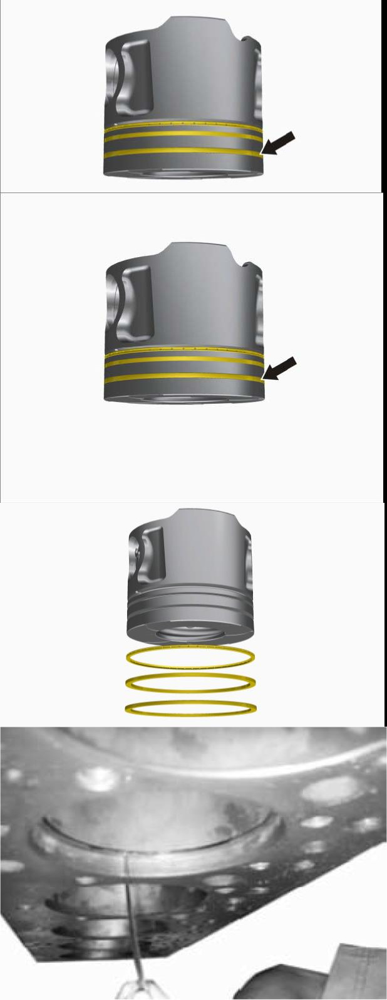

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**K. PISTON AND PISTON RINGS INSPECTION**
1. 

Remove piston rings from piston using ring 
expander. 

9. 

8. Butt clearance of piston ring should be 
measured in unworn portion of cylinder bore 
In case of any piston ring with any one of this 
defect, complete ring set should be replaced. 
10. When cylinder bores are re-bored or honed, 
pistons and rings of appropriate size should be 
used. Piston size grade is stamped on piston 
crown. 

11. 

Install piston rings in their respective position 
on piston using ring expander. 

2. 
3. 

Remove carbon deposits from piston. 
Clean piston and piston rings thoroughly. 

4. 

5. 

In case cylinder bore taper and ovality is within 
specified limit, then same piston and piston 
rings may be reused. 
Examine pistons for cracks, scoring, other 
damages, like Ring groove wear, piston pin 
bore wear, spring clip groove wear/ damage 
etc. 

12. Stagger piston rings gaps such that they are 
120°apart (with butt gap not in line with piston 
pin) 

6. 

7. 

In case any one of the piston has any defect, 
all the piston set should be replaced. 
Examine piston rings for scoring, lateral 
clearance in piston ring groove and butt 
clearance in cylinder bore. 

8 

**Stage**

**Connecting Rod small end**

Parent bore diameter (mm) 

39 H6 

39.2 H6 

Max. permissible Cylindricity of connecting rod small end parent bore 

Connecting rod small end bush inside diameter. (to be finished after installation) 
(Piston pin oiled has thumb push fit in small end bush) 

Max. Permissible out of parallelism (bend) between connecting rod small end 
and big end parent bores measured from centre line of connecting rod big end. 

Centre to centre distance between connecting rod small end and big end parent 
bores. 

Maximum permissible twist of connecting rod 

Connecting rod big end parent bore diameter 

Max. permissible perpendicularity of connecting rod big end parent bore 
Cylindricity 

**Stage**

**Connecting Rod with bearing shell big end parent**
**bore diameter**

**Crank pin journal diameter**
**(mm)**

Normal (STD) 

62.016 – 62.051 

61.965 – 61.985 

Normal 1 

61.916 – 61.951 

61.865 – 61.885 

Repair 1 

61.766 – 61.801 

61.715 – 61.735 

Repair 2 

61.516 – 61.551 

61.465 – 61.485 

Repair 3 

61.266 – 61.301 

61.215 – 61.235 

Repair 4 

61.016 – 61.051 

60.965 – 60.985 

Bearing shells to be selected such that clearance is maintained as 

0.031 – 0.086 

Pre tension of connecting rod big end bearing shells 

0.090 – 0.120 

Maximum permissible difference in weight of connecting rods in one engine 

10 gms 

Connecting rod big end axial play 

0.3 to 0.56 

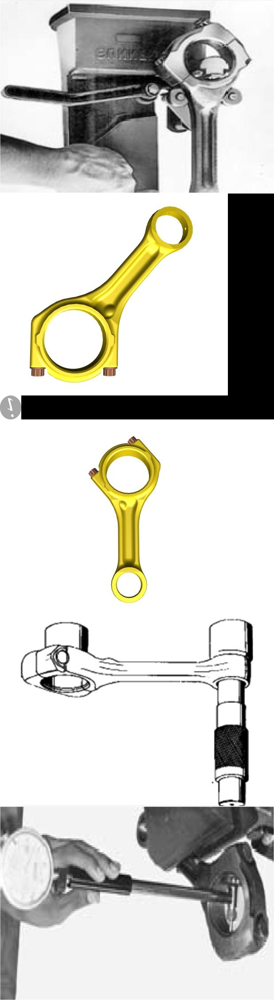

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

4. 

**M. CONNECTING ROD INSPECTION**

1. 

2. 

Install connecting rod bearing caps without 
bearing shells on connecting rod. 
Tighten connecting rod bearing cap mounting 
bolts to specified torque. 

Measure twist and bend of connecting rod with 
feeler gauge with respect to vertical face of the 
connecting rod alignment gauge in vertical and 
horizontal plane at a distance of 50 mm from 
line joining centers of connecting rod small end 
and big end bosses. 

**NOTE**

that 

identification numbers 

• 

Ensure 
for 
connecting rod and connecting rod bearing 
cap are matched and notches for bearing 
shells are on the same side. 

3. 

Check twist and bend of connecting rod by 
using new piston pin in connecting rod small 
end bush. 

5. 

Check connecting rod big end parent bore 
dimension (1). 

10 

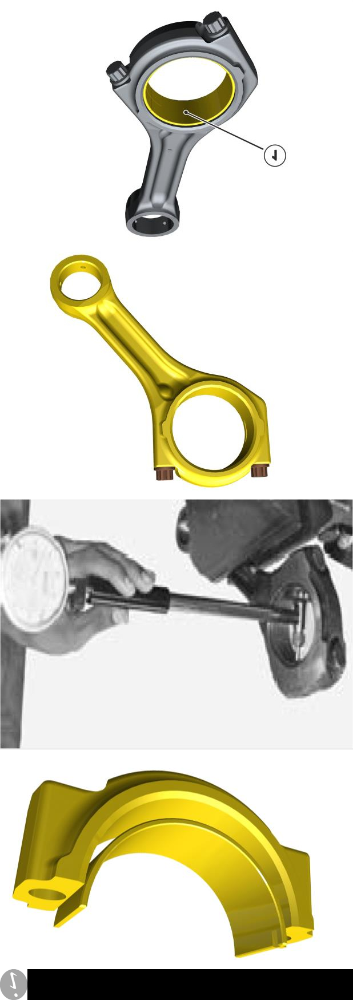

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

10. 

Install connecting rod bearing cap with bearing 
shell on connecting rod. Tighten connecting rod 
bearing cap MTG. screws to specified torque. 

6. 

11. 

Measure connecting rod bearing bore. Record 
the readings in the format given in this manual. 

7. 

8. 

in one engine 

9. 

12. 

If connecting rod big end parent bore is slightly 
more than maximum permissible limits, it is 
possible to reclaim the connecting rod provided 
the wear is confined only to connecting rod 
bearing cap. In such cases the connecting rod 
bearing cap mating surface can be slightly 
faced. The parent bore should then be finished 
on a connecting rod boring machine. 
Ensure that the connecting rod big end and 
small end axis are parallel to each other within 
the specified limits. Centre to centre distance 
between connecting rod small end and big end 
is maintained within specified limits. 
If one or more connecting rods are to be 
replaced, ensure that difference in weight of 
connecting rod 
is within 
permissible limits. 
Install new pair of connecting rod bearing shell 
according to size of crank pin journal diameter, 
making sure that securing lugs of bearing shells 
are properly seated in grooves of connecting 
rod and its bearing cap. 

If connecting rod big end parent bore 
dimension is maintained within specified limits, 
proper bearing bore dimension is automatically 
achieved. 

**NOTE**

• 

Lower and upper bearing halves are not 
interchangeable. 

11 

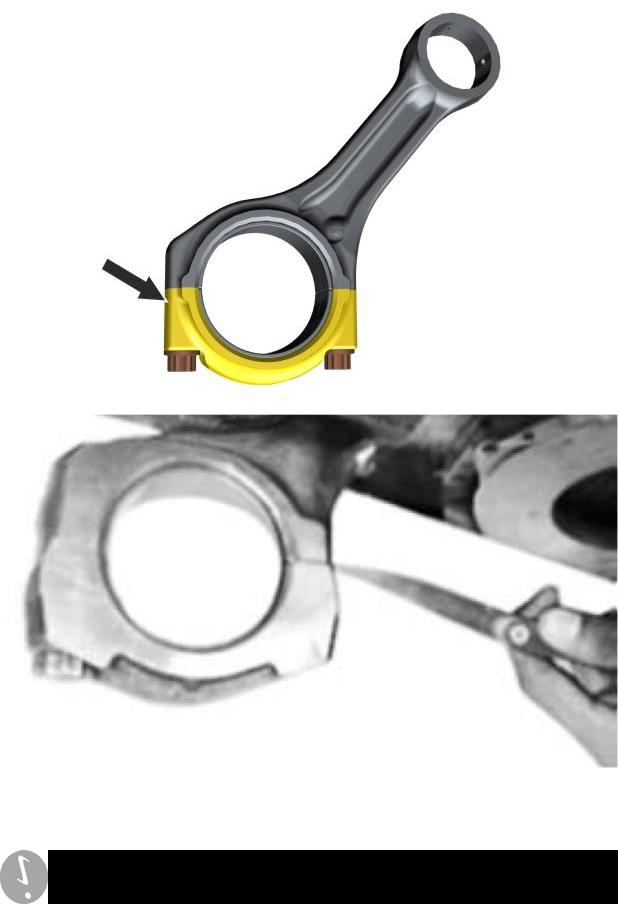

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

13. 

However, it must be physically measured and 
confirmed. Measure pretension of connecting 
rod bearing shell with a feeler gauge after 
loosening connecting rod bearing cap mounting 
screws on opposite side of bearing shell lug. 

**NOTE**

• 

Connecting rod bearing shells are precision 
finished and should not be bored or scraped. 

12 

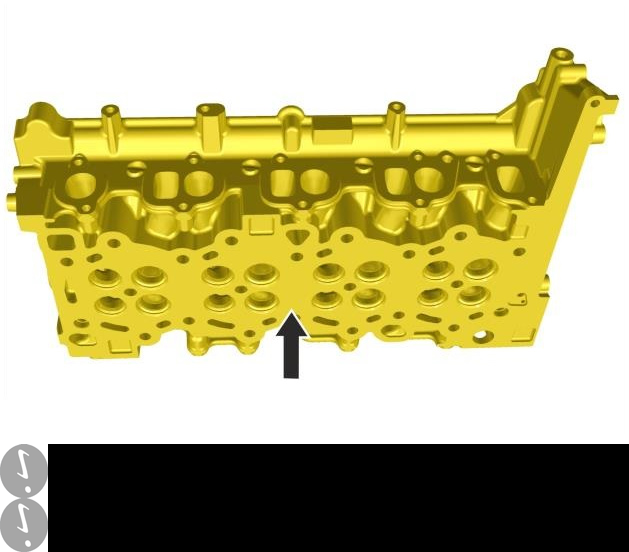

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**N. CYLINDER HEAD**

**INSPECTION OF CYLINDER HEAD**

**CHECKING CYLINDER HEAD MATING SURFACE**

Using a straight edge and feeler gauge, check evenness of cylinder head parting surface with crankcase. If 
unevenness exceeds specified values, replace cylinder head. 

1. Permissible unevenness of cylinder head mating surface:- 0.1 (Length wise) 
2. Permissible unevenness of cylinder head mating surface:- 0.025 (100X100 mm) (Cross wise) 

**NOTE**

• Re-machining of cylinder head top and bottom surfaces are not permitted during service 

**O. CYLINDER BLOCK INSPECTION**
1. Check cylinder block for cracks by pressure 
testing method. Clean cylinder bores, bearing 
in crank case 
surfaces, oil passages 
thoroughly. Check water jackets for leakages by 
blowing air at a pressure of 5 bar & then dipping 
the cylinder block in the hot water (Temp of 
water 70° to 80°C) 

**NOTE**

• 

The block with any leakages / cracks should 
be discarded 

13 

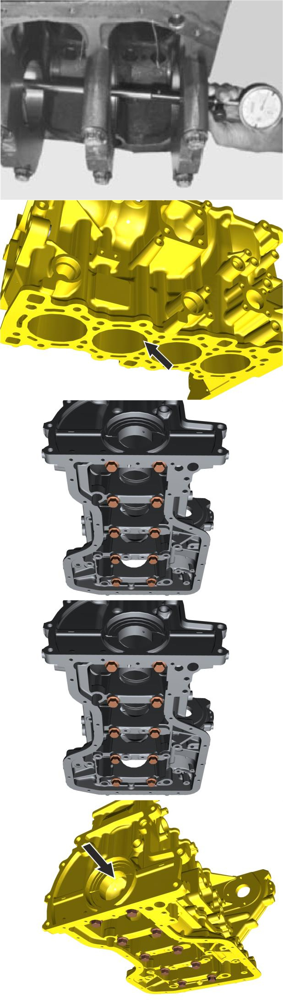

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

2. 

Check crankcase mating surface with cylinder 
head for unevenness with the help of straight 
edge and feeler gauge. If necessary grind this 
surface just too clear unevenness. Measure 
across the length and also across the breath. 

6. 

3. 

7. 

4. 

Ensure that the minimum height of crank case 
is not less than the specified minimum height. 
Tighten main bearing & other M-8 (bedplate to 
block bolts) bolts to specified torque 

Install new pairs of main bearing shells 
according to size of crank shaft main bearing 
journal diameter, making sure that securing 
lugs of bearing shells are properly seated in 
grooves of crank case and main bearing caps. 
Install bed plate with bearing shells in their 
respective position on crank case. Tighten main 
bearing cap mounting bolts 
in specified 
sequence to specified torque. Measure main 
bearing bore. 

5. 

8. 

Check crank case main bearing parent bore 
dimensions and then dismantle the bedplate. 

If main bearing parent bore dimensions are 
within specified limits, proper main bearing bore 
dimension is automatically achieved. 

14 

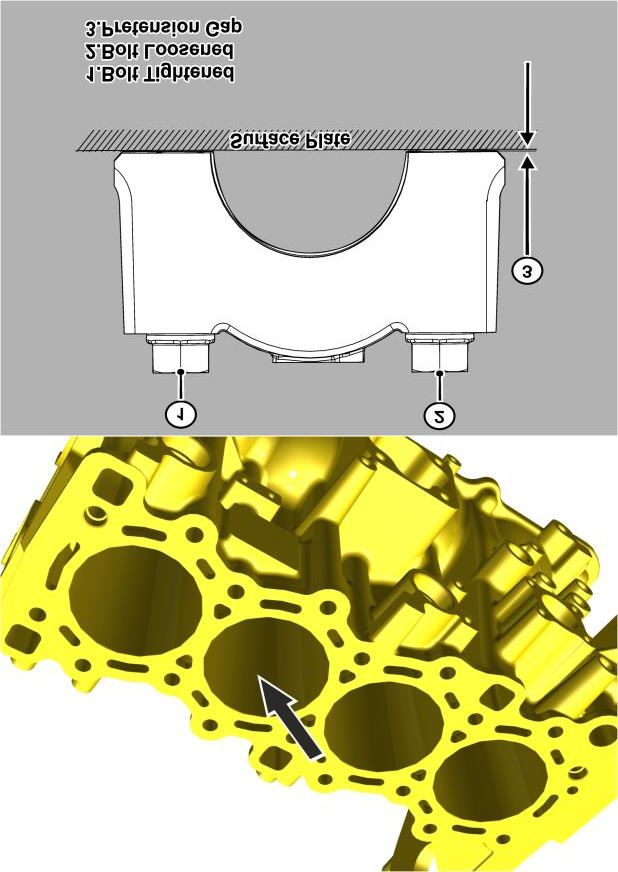

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

9. 

Loosen bed plate main bearing cap mounting 
bolt. Now using a feeler gauge measure the 
pretension of main bearing shell. As the main 
bearing caps are guided, the measurement has 
to be done on a flat surface and not on cylinder 
block. 

10. 

11. 

12. 

Main bearing shells are precision finished and 
should not be bored or scrapped. 
Select new pair of thrust washer according to 
crank shaft 4th main journal width. 
Crush height for main bearing and connecting 
rod bearing: 0.085 to 0.09mm. 

**P. CYLINDER BORES**
1. 
2. 

Clean cylinder bores thoroughly. 
Check cylinder bore dimension, taper and 
ovality. 

3. 

If taper and ovality is found to exceed specified 
limit or bore is excessively worn out then 
replace the block. 

15 

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**Q. CYLINDER HEAD GASKET SELECTION**

**Piston Projection (mm)**

**Gasket Thickness (mm)**

**Identification**

1.3 

0.40 + 0.05 

**1**HOLES 

1.4 

0.50 + 0.05 

1.**5**

**2**HOLES 

**3**HOLES 

0.60 + 0.05 

1.**6**

**4**HOLES 

0.70 + 0.05 

**R. CRANK SHAFT**

**Stage**

**Crank case main bearing bore diameter with bearing**
**shell (mm)**

**Crank case main bearing**
**journal diameter (mm)**

78.02 – 78.052 

77.96 – 77.98 

Normal 
(STD) 

Normal1 

77.92 – 77.952 

77.86 – 77.88 

Repair 1 

77.77 –77.802 

77.71 – 77.73 

Repair 2 

77.52 –77.552 

77.46 – 77.48 

Thickness of 4th bearing thrust washers ———— Standard – (33.5+0.06 mm) 
Repair size 0.300 (33.8+0.06 mm) 
Repair size 0.500 (34+0.06 mm) 

2.450 – 2.500 mm 
2.600 – 2.650 mm 
2.700- 2.750 mm 

End play of crankshaft 

Fillet radius of main bearing journals 

Fillet radius of crank pin journal 

Width 1st, 2nd, 3rd, and 4th main bearing journals 

Width crank pin journal 

Maximum permissible circularity of main journal 

Cylindricity of main bearing journal 

Maximum permissible Cylindricity of crank pin 

Maximum permissible run out of 2nd,3rd and4th 5th main bearing journals 

Maximum permissible out of parallelism between crank pin and main journal axis 

Pre tension of main bearing shells 

Hardness of crank shaft main bearing and crank pin journals 

Main bearing parent bore diameter. In crankcase 

Maximum permissible concentricity of main bearing parent bore 

Maximum permissible Cylindricity of main bearing parent bore 

Crankshaft journal to main bearing clearance 

Crankpin Journal Circularity 

0.15 – 0.36 mm 

2.75 – 3.25 mm 

2.5 – 3 mm 

33.5 + 0.16 mm 

33.5 + 0.16mm 

0.008 mm 

0.008 mm 

0.05 mm 

0.02 mm 

0.01 mm 

0.085 – 0.120 mm 

56 ±3 HRC 

83 +0.02 

0.03 mm 

0.01 mm 

0.040 – 0.092 mm 

0.005 

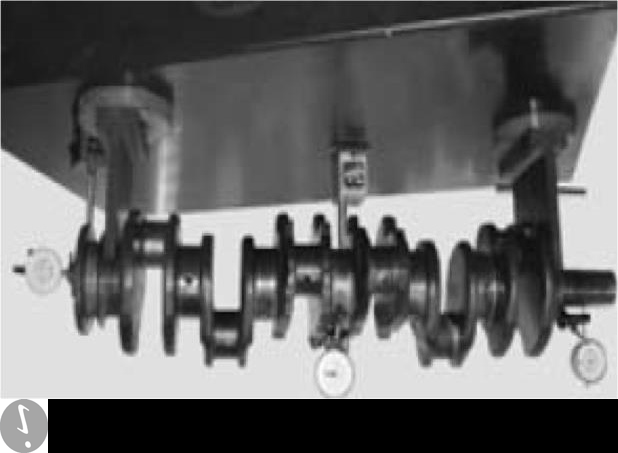

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**S. CRANKSHAFT INSPECTION**
Clean and carry out visual inspection of crank shaft 
for the following: 

1. 

2. 
3. 

4. 

Overheating of journals, this is indicated by 
bluish brown colour. 
Scoring marks on journals 
Cracks, which should be checked on magnetic 
crack detector 
Check crank shaft run out by supporting it on V- 
block at 1st and 5th main bearing journals. 

5. 

If run out exceeds permissible limits, 
discard the crank shaft. 

6. Similarly check lateral and radial run outs 

of flywheel mounting flange. 

7. Check crank shaft main bearing and crank 

pin journal dimension. 

8. Thoroughly clean crank shaft with 

kerosene. Use wire brush for cleaning oil 
holes 

9. Apply grease to all machined surfaces, if 

crank shaft is to be stored. Crank shaft must 
always be stored in vertical position. 
10. Thoroughly clean main bearing caps 

and corresponding machined 
surfaces 

crankcase. 

of 

11. Install main bearing caps without 

in 

respective 

bearing shells 
their 
positions on crankcase. 

**NOTE**

• 

Ensure that the serial numbers on crank 
case and main bearing caps are matching. 
Also caps are 
in order and notches 
forbearing shells are on same side. 

17 

**ENGINE REPAIR AND ADJUSTMENT PARAMETERS**

**T. ASSEMBLY CLEARANCES**

Connecting rod clearance (Big End) 

0.031 mm / 0.086 mm 

Connecting rod Axial play (Big End) 

0.3 mm / 0.56 mm 

Connecting rod small end bush clearance 

0.020 mm / 0.036 mm 

Camshaft Bearing Clearance 

0.030 mm to 0.072 mm 

Camshaft bearing axial play 

0.065 mm to 0.198 mm 

Valve Stem Clearance (Inlet) 

0.021 mm to 0.051 mm 

Valve stem Clearance (Exhaust) 

0.031 mm to 0.061 mm 

Piston Clearance on skirt (Bore to piston thrust side) 

0.098 mm / 0.122 mm 

Main bearing clearance 

0.040 mm / 0.092 mm 

Gap between cam sensor and cam sensor wheel in assembled condition 

0.5 mm to 1.5 mm 

Injector tip from bottom surface of cylinder head (NTP) 

2.63 ± 0.35 mm 

Crankshaft axial play 

0.15 mm / 0.36 mm 

Minimum clearance between crankweb with R5 radius and block 

1.1 mm 

0.020 mm to 0.062 mm 

0.30 ± 0.05 mm 

0.30 ± 0.05 mm 

0.020 mm to 0.059 mm 

0.2 mm to 0.6 mm 

In [ ]:
import openparse

basic_doc_path = "table_sample.pdf"
parser = openparse.DocumentParser()
parsed_basic_doc = parser.parse(basic_doc_path)

for node in parsed_basic_doc.nodes:
    display(node)

In [ ]:
parsed_basic_doc.model_dump()

{'nodes': [{'embedding': None,
   'node_id': '52c34d97-3150-4db5-8a4e-4b90f4d01256',
   'variant': {'text'},
   'tokens': 316,
   'images': [],
   'bbox': [{'page': 1,
     'page_height': 792.0,
     'page_width': 612.0,
     'x0': 82.92,
     'y0': 266.23,
     'x1': 500.06,
     'y1': 658.49}],
   'text': 'A. Valve and Valve Seat Dimensions……………………………………...(1-2) \nB. Valve Seat Insert and Bore Diameter in Cylinder Head……...(3) \nC. Valve Guide Bore Diameter in Cylinder Head…………………….(3) \nD. Valve Inspection…………………………………………………………….….(4) \nE. Valve Seat …………………………………………………………………….…..(4) \nF. Valve Seat Inserts Removal.…………………………………………….….(4) \nG. Crankcase………………………………………………………………….….……(5) \nH. Piston and Piston Bore Sizes……………………………………....……..(6) \nI. Piston Rings………………………………………………………….……….……(7) \nJ. Repair Sizes for Piston Rings…………………………………….….……..(7) \nK. Piston and Piston Ring Inspection……………………………………….(8) \nL. Connecting Rod…………………………………………………………………..(9) \nM. Connecting Rod Inspec

In [ ]:
parser_table = openparse.DocumentParser(
    table_args={
        "parsing_algorithm": "pymupdf",
    }
)

In [ ]:
parsed_table_data = parser_table.parse("table_sample.pdf")

In [ ]:
len(parsed_table_data.nodes)

23

In [ ]:
parsed_table_data.model_dump()

{'nodes': [{'embedding': None,
   'node_id': 'c51d1172-f7f3-4b1a-b262-b05d94647226',
   'variant': {'text'},
   'tokens': 316,
   'images': [],
   'bbox': [{'page': 1,
     'page_height': 792.0,
     'page_width': 612.0,
     'x0': 82.92,
     'y0': 266.23,
     'x1': 500.06,
     'y1': 658.49}],
   'text': 'A. Valve and Valve Seat Dimensions……………………………………...(1-2) \nB. Valve Seat Insert and Bore Diameter in Cylinder Head……...(3) \nC. Valve Guide Bore Diameter in Cylinder Head…………………….(3) \nD. Valve Inspection…………………………………………………………….….(4) \nE. Valve Seat …………………………………………………………………….…..(4) \nF. Valve Seat Inserts Removal.…………………………………………….….(4) \nG. Crankcase………………………………………………………………….….……(5) \nH. Piston and Piston Bore Sizes……………………………………....……..(6) \nI. Piston Rings………………………………………………………….……….……(7) \nJ. Repair Sizes for Piston Rings…………………………………….….……..(7) \nK. Piston and Piston Ring Inspection……………………………………….(8) \nL. Connecting Rod…………………………………………………………………..(9) \nM. Connecting Rod Inspec

In [ ]:
parsed_table_data.nodes

[Node(id_='c51d1172-f7f3-4b1a-b262-b05d94647226', elements=(TextElement(text='A. Valve and Valve Seat Dimensions……………………………………...(1-2) \nB. Valve Seat Insert and Bore Diameter in Cylinder Head……...(3) \nC. Valve Guide Bore Diameter in Cylinder Head…………………….(3) \nD. Valve Inspection…………………………………………………………….….(4) \nE. Valve Seat …………………………………………………………………….…..(4) \nF. Valve Seat Inserts Removal.…………………………………………….….(4) \nG. Crankcase………………………………………………………………….….……(5) \nH. Piston and Piston Bore Sizes……………………………………....……..(6) \nI. Piston Rings………………………………………………………….……….……(7) \nJ. Repair Sizes for Piston Rings…………………………………….….……..(7) \nK. Piston and Piston Ring Inspection……………………………………….(8) \nL. Connecting Rod…………………………………………………………………..(9) \nM. Connecting Rod Inspection…………………………………….…………..(10-12) \nN. Cylinder Head……………………………………………………………..……..(13) \nO. Cylinder Block Inspection………………………………………………...…(13-15) \nP. Cylinder Bore…………………………………………………………..…..…….(15) \nQ. Cylinder Head Gasket Selectio

In [ ]:
parsed_table_data.nodes[3]

**B.**

**VALVE SEAT INSERT AND BORE DIAMETER IN CYLINDER HEAD**

<table border="1">
<tr><th>SIZE</th><th>VALVE SEAT INSERT BORE
DIAMETER IN CYLINDER HEAD</th><th>VALVE SEAT INSERT OUTSIDE
DIAMETER (mm)</th></tr>
<tr><td>SIZE</td><td>VALVE SEAT INSERT BORE
DIAMETER IN CYLINDER HEAD</td><td>VALVE SEAT INSERT OUTSIDE
DIAMETER (mm)</td></tr>
<tr><td>INLET</td><td> </td><td> </td></tr>
<tr><td>NORMAL</td><td>34 +0.021</td><td>34.0 +0.080/+0.065</td></tr>
<tr><td>NORMAL 1</td><td>34.3 +0.021</td><td>34.3 +0.080/+0.065</td></tr>
<tr><td>OUTLET</td><td> </td><td> </td></tr>
<tr><td>NORMAL</td><td>31.1 +0.021</td><td>31.1 +0.080/+0.065</td></tr>
<tr><td>NORMAL 1</td><td>31.3 +0.021</td><td>31.3 +0.080/+0.065</td></tr>
</table>

In [ ]:
basic_doc_path

'table_sample.pdf'

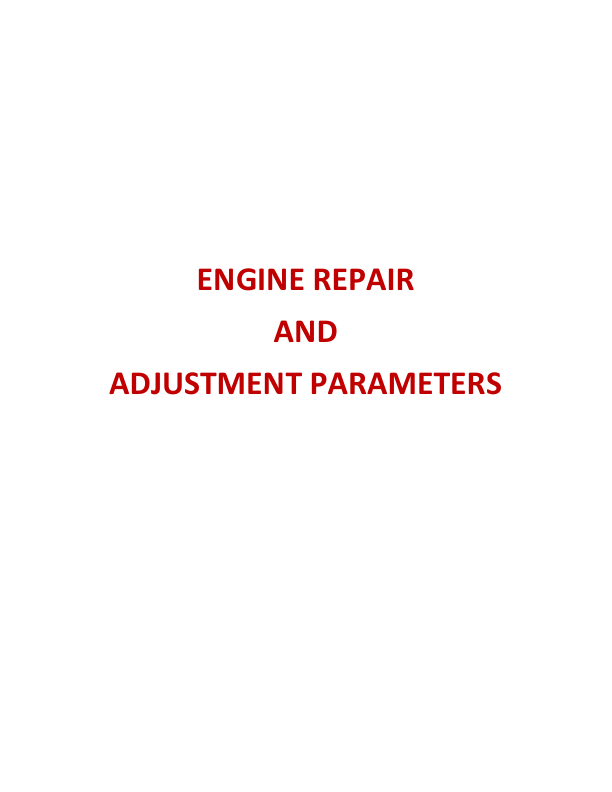

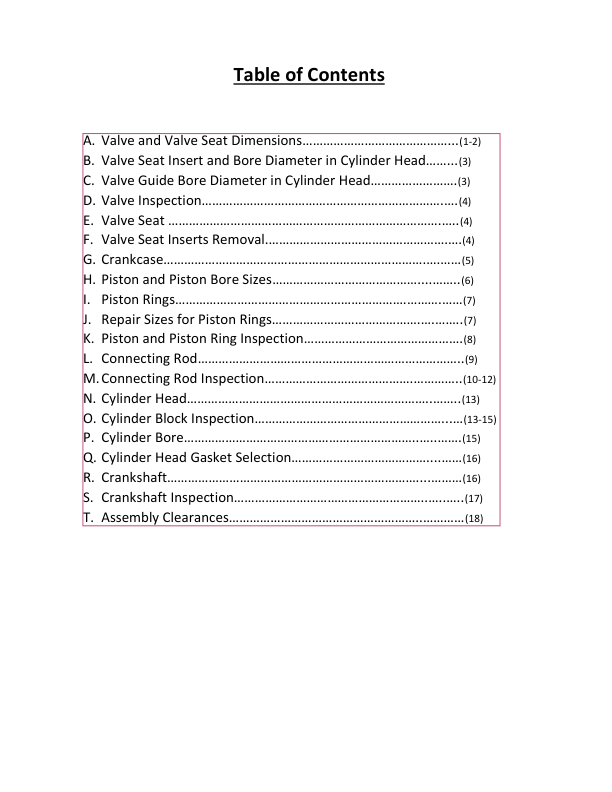

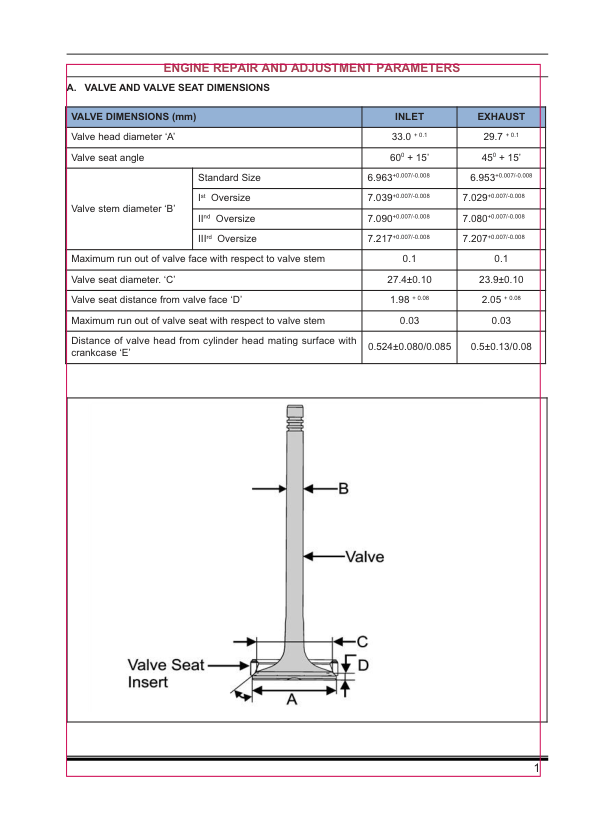

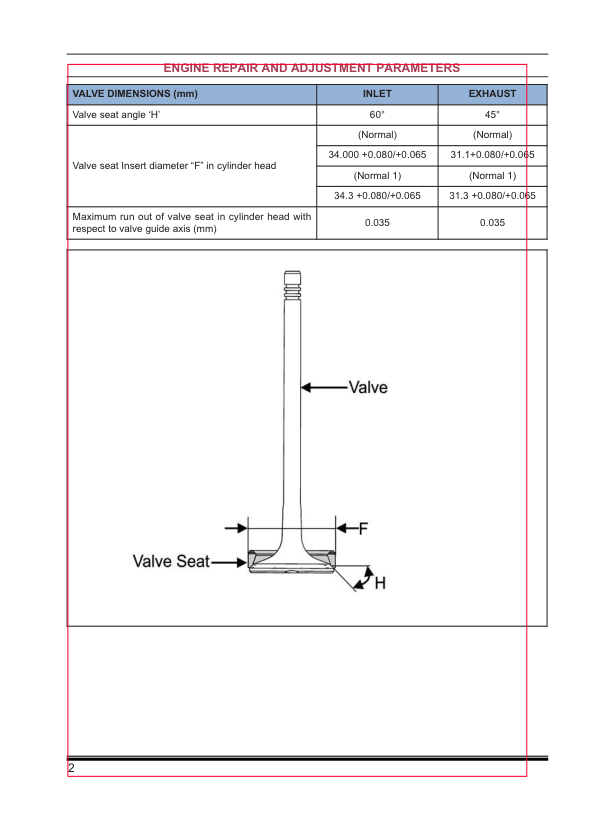

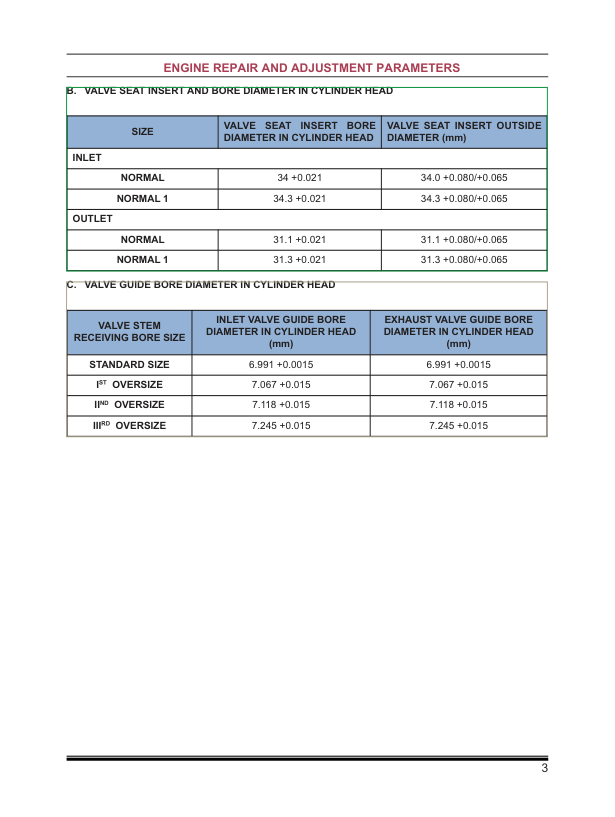

...

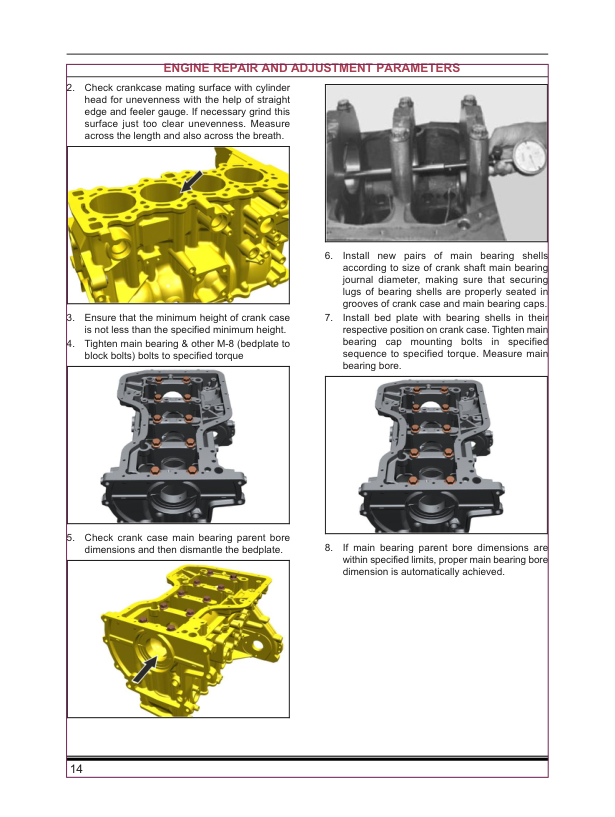

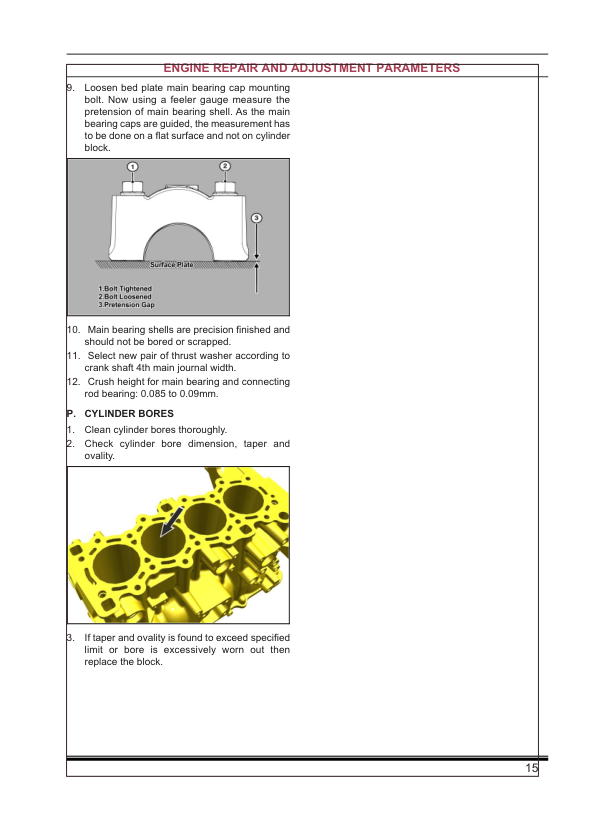

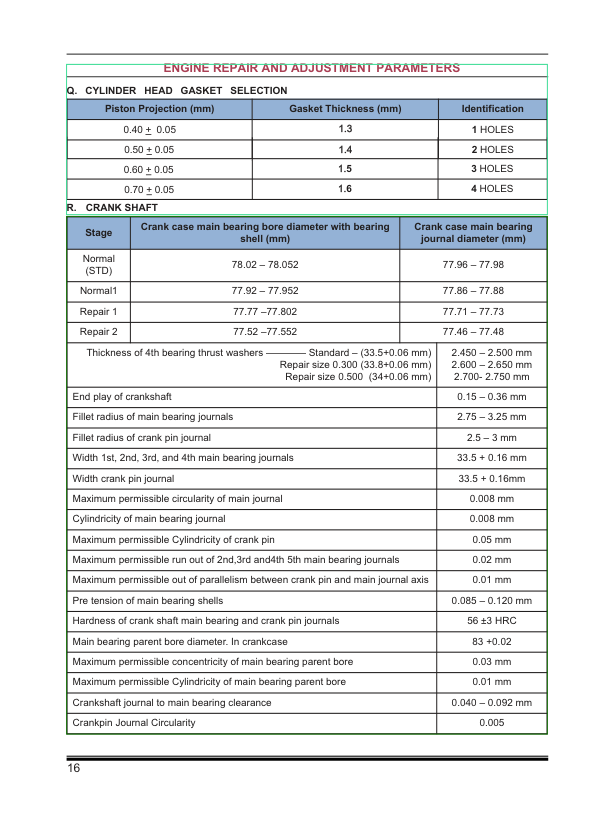

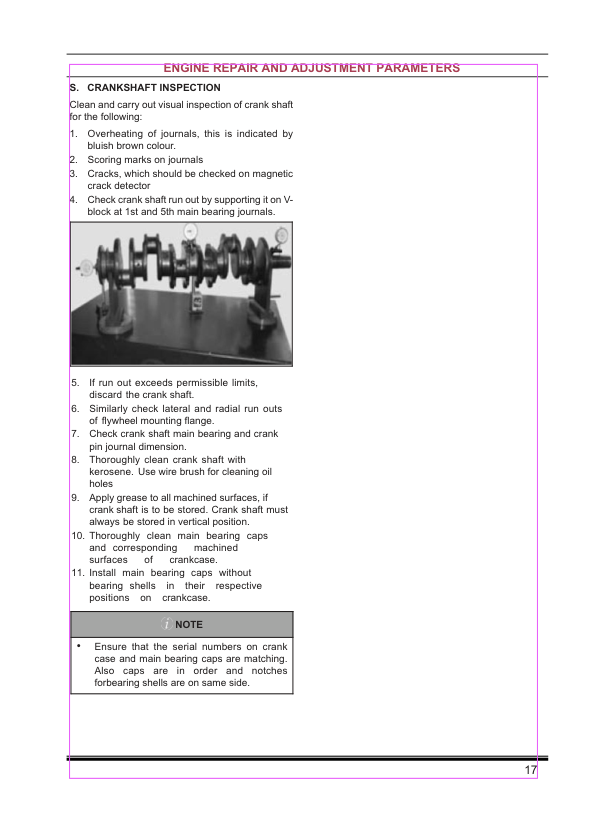

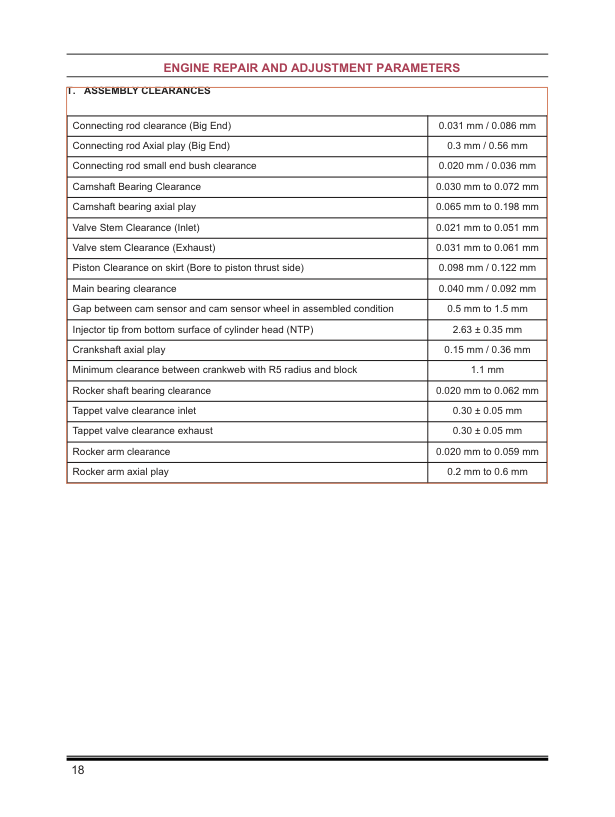

In [ ]:
pdf = openparse.Pdf(basic_doc_path)
pdf.display_with_bboxes(
    parsed_table_data.nodes,
)

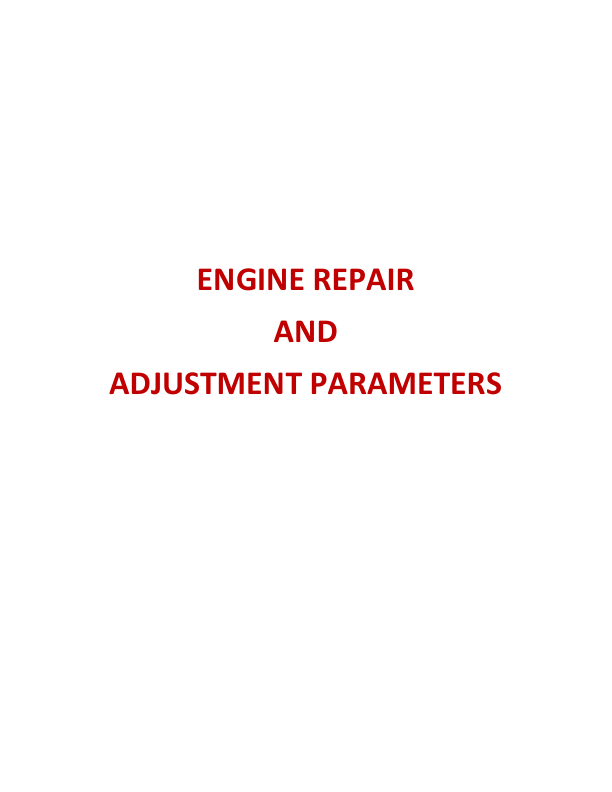

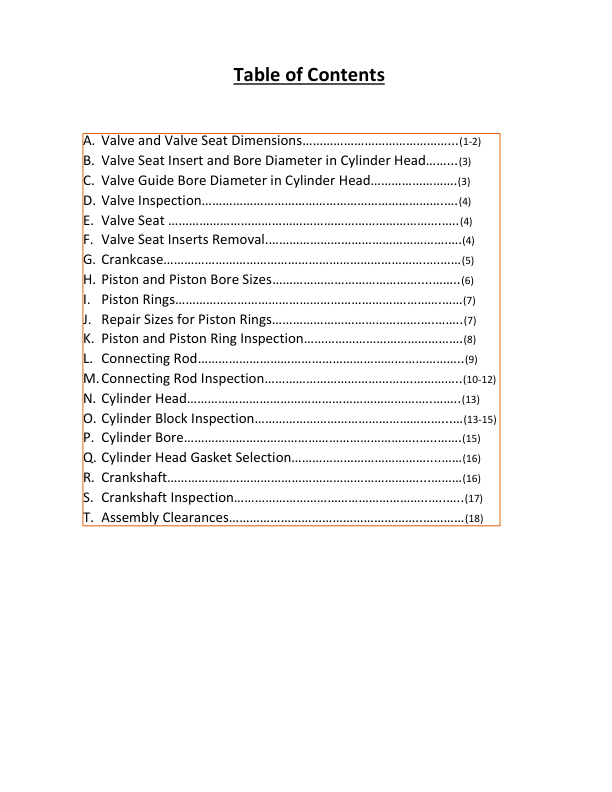

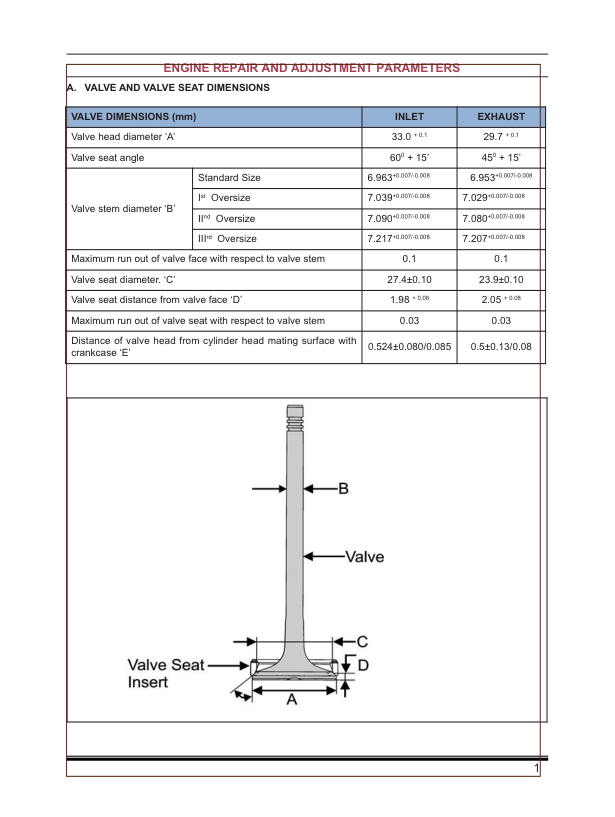

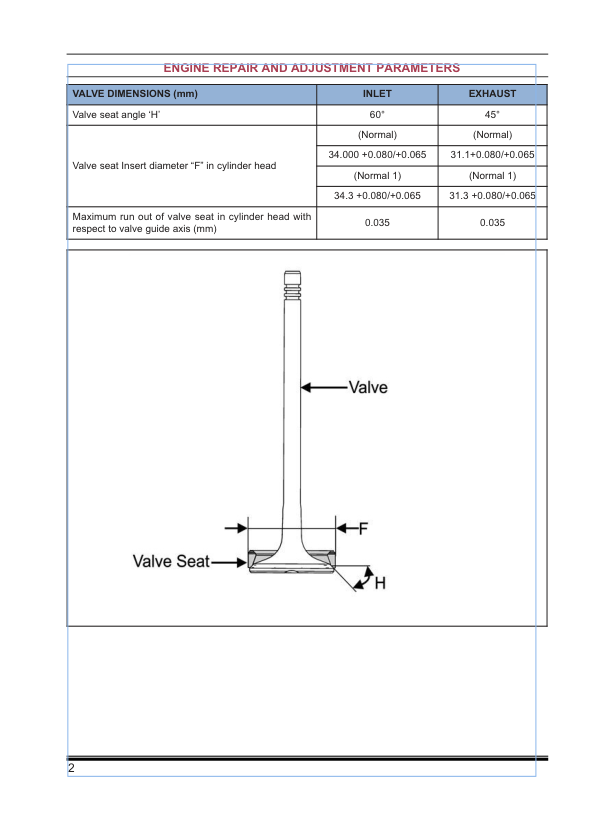

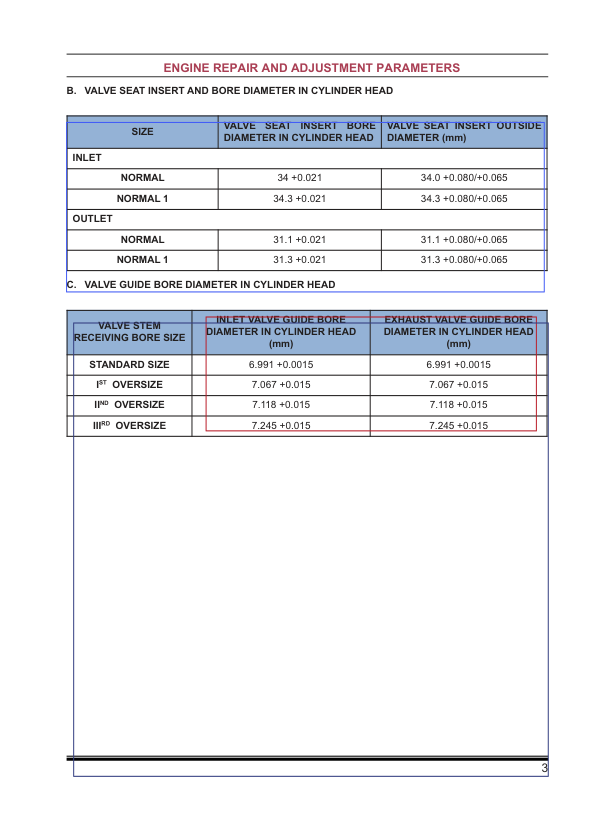

...

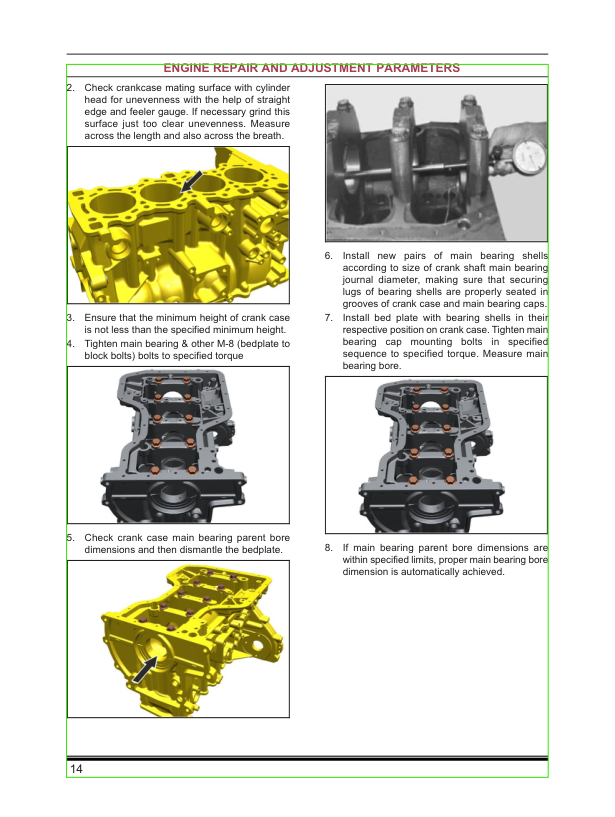

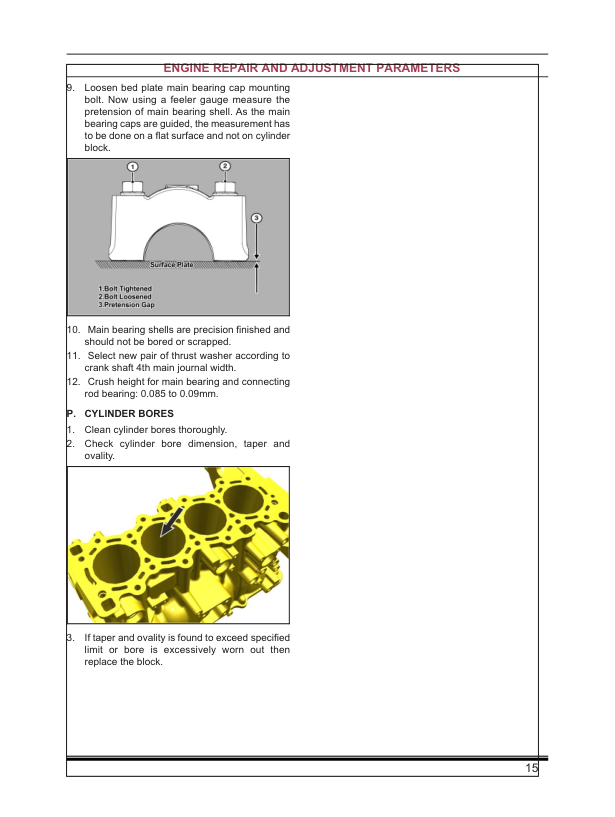

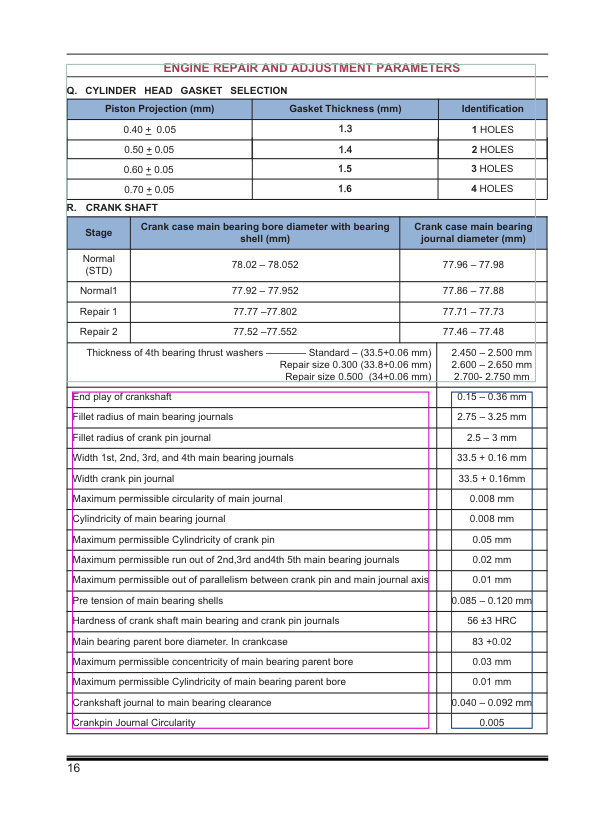

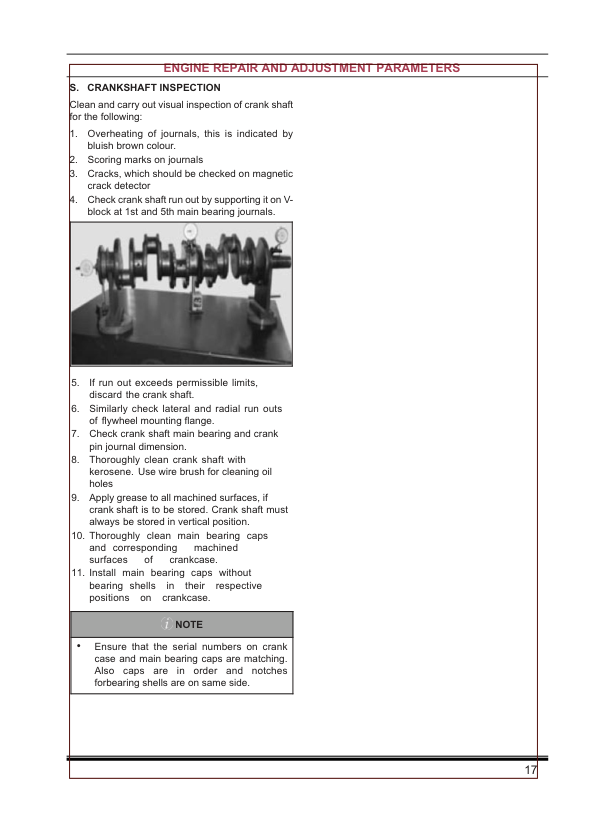

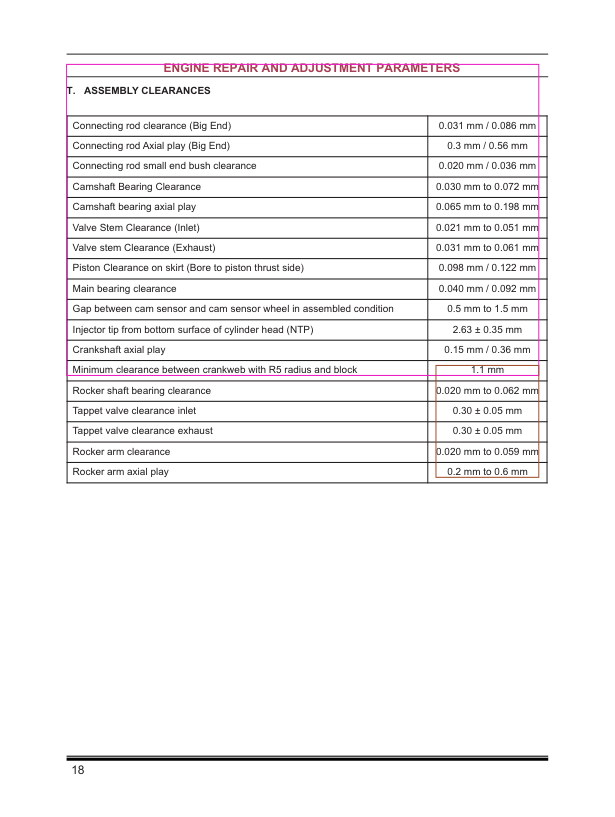

In [ ]:
pdf = openparse.Pdf(basic_doc_path)
pdf.display_with_bboxes(
    parsed_basic_doc.nodes,
)

In [ ]:
from openparse import processing, Node
from typing import List


class CustomCombineTables(processing.ProcessingStep):
    """
    Let's combine tables that are next to each other
    """

    def process(self, nodes: List[Node]) -> List[Node]:
        new_nodes = []
        print("Combining concurrent tables")
        for i in range(len(nodes) - 1):
            if "table" in nodes[i].variant and "table" in nodes[i + 1].variant:
                new_node = nodes[i] + nodes[i + 1]
                new_nodes.append(new_node)
            else:
                new_nodes.append(nodes[i])

        return new_nodes


# copy the default pipeline (or create a new one)
custom_pipeline = processing.BasicIngestionPipeline()
custom_pipeline.append_transform(CustomCombineTables())

Combining concurrent tables


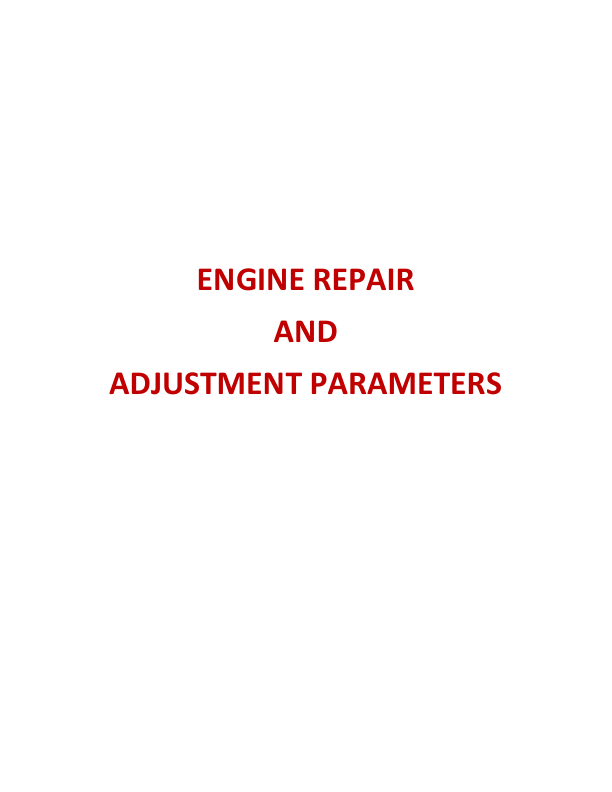

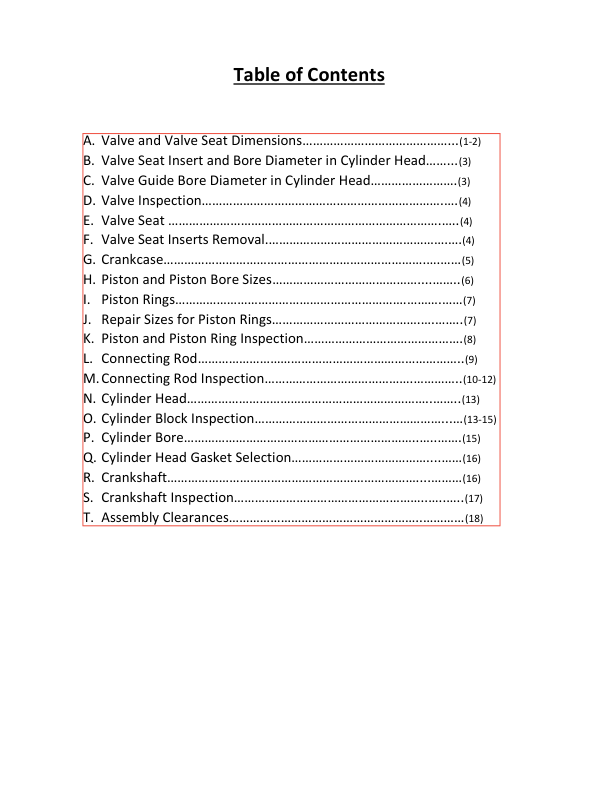

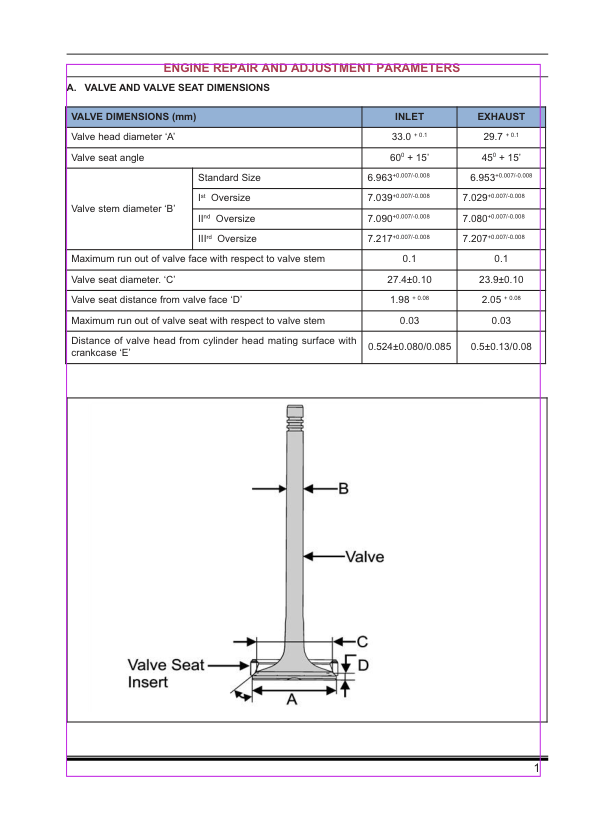

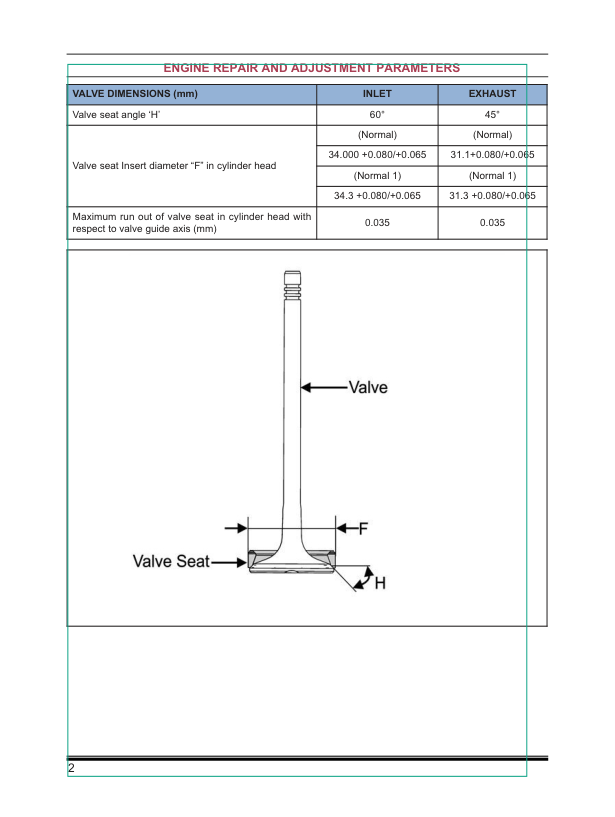

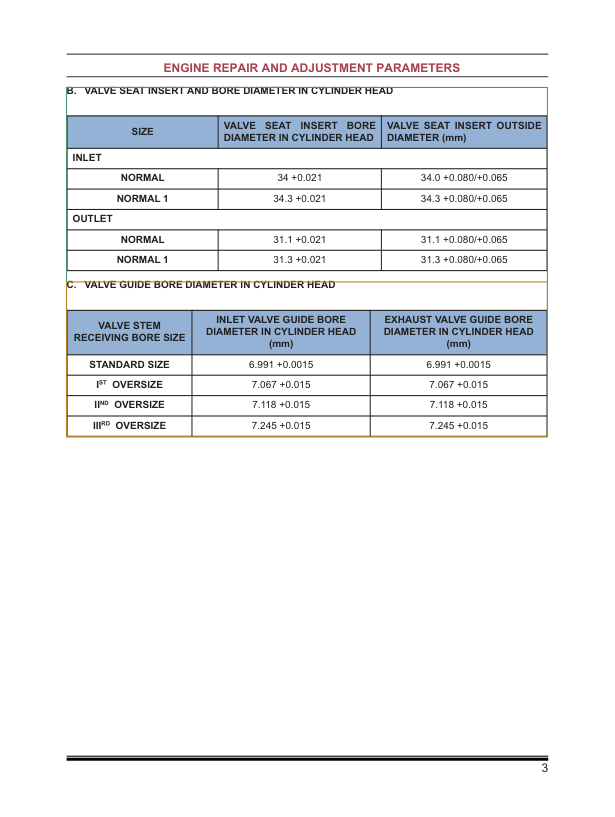

...

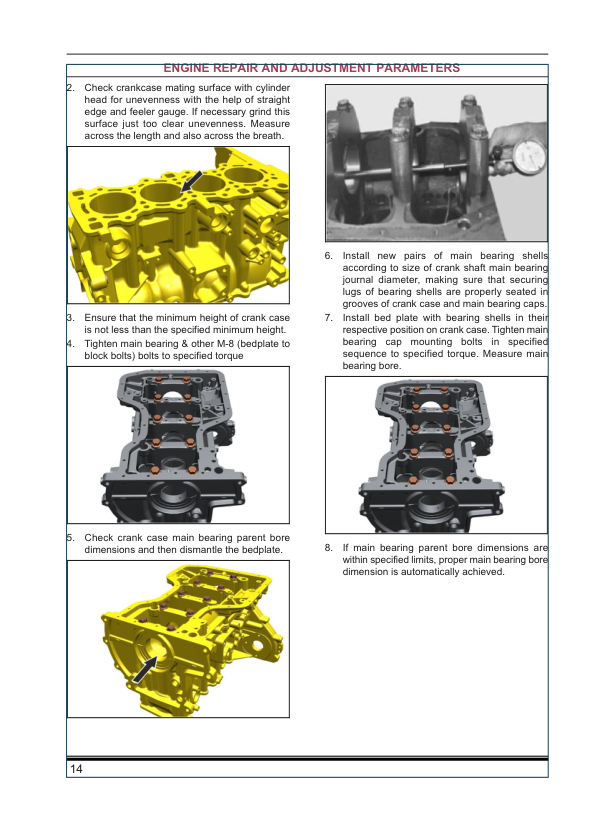

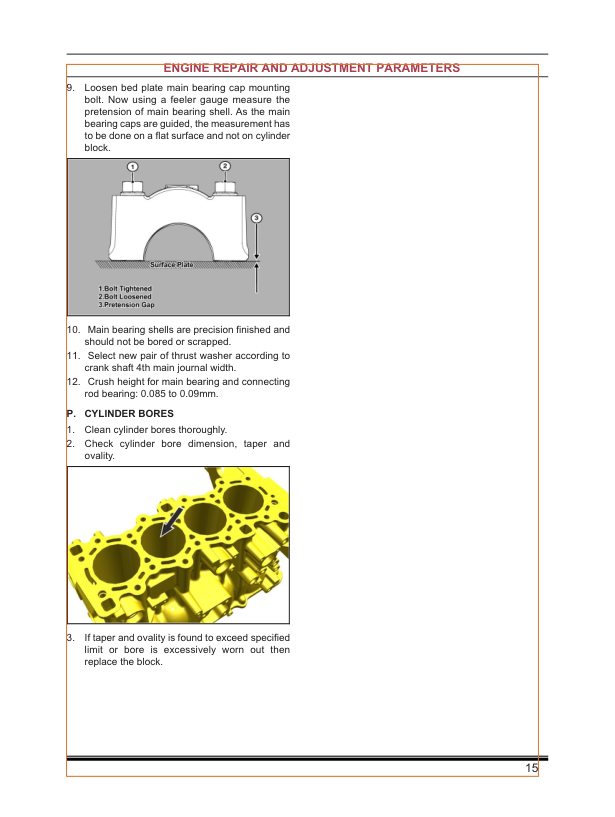

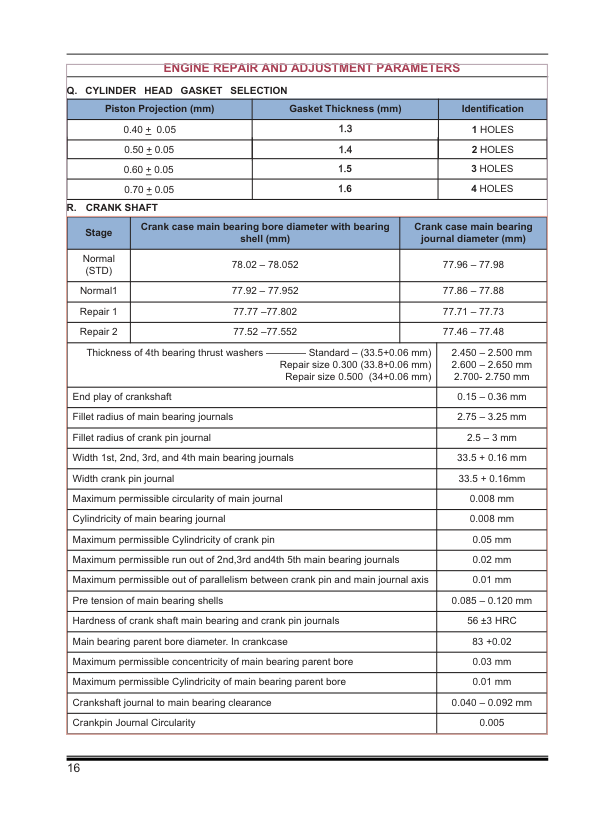

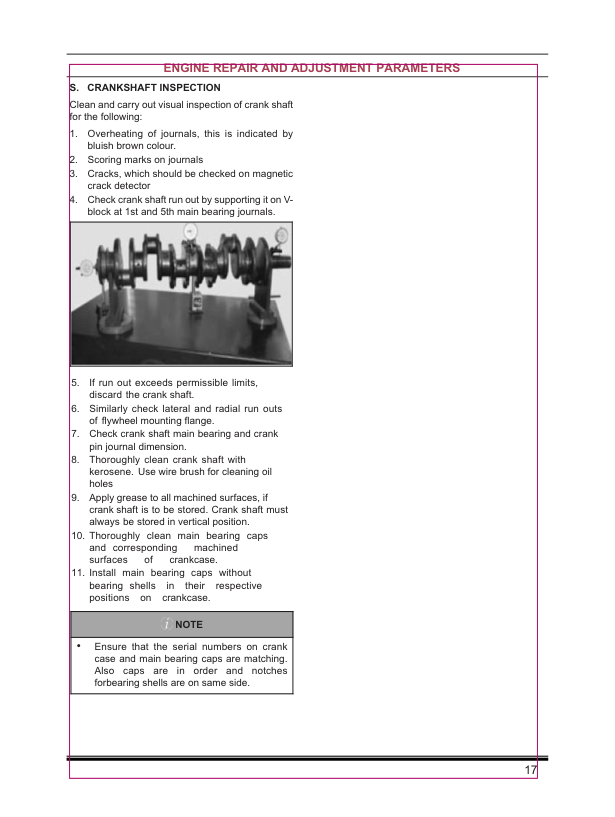

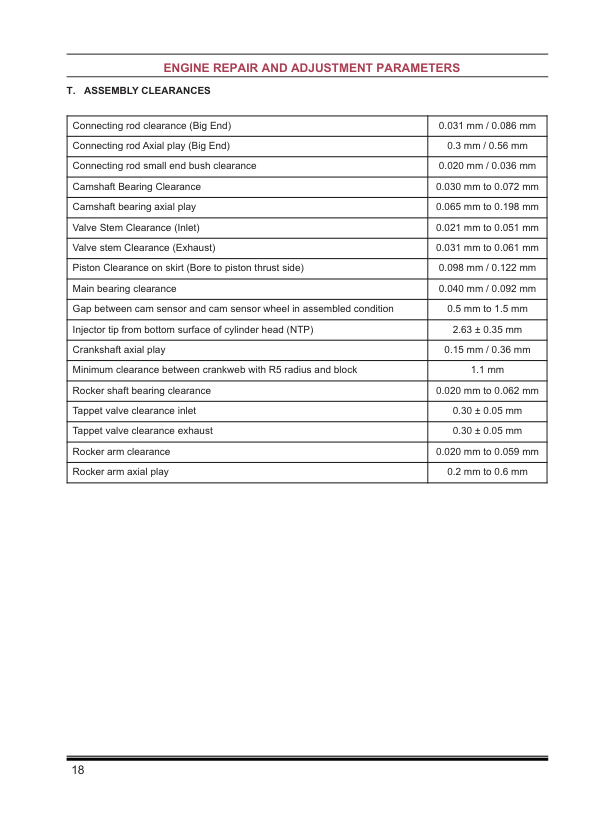

In [ ]:
parser = openparse.DocumentParser(
    table_args={"parsing_algorithm": "pymupdf"}, processing_pipeline=custom_pipeline
)
custom_parse = parser.parse(basic_doc_path)

doc = openparse.Pdf(file=basic_doc_path)
doc.display_with_bboxes(custom_parse.nodes)

## Table in 2 pages


In [ ]:
loader = PDFPlumberLoader("/content/tarunjain_redhenlab_gsoc24.pdf")
plumber_check = loader.load()

In [ ]:
len(plumber_check)

10

In [ ]:
print(plumber_check[8].page_content)

● Few uses can be: Document Translation, Multi- Language
Summarization, Question and Answers and so on.
f) Final Evaluation (August 19 to August 26)
● Buffer time, if anything is left pending, then I will utilise this time.
● Meet with Mentors and submit the final report.
● Write a blog regarding my GSoC’24 experience.
7.1 Project Timeline Summary
Time Period GSoC 24 Project Phase Summarised Task
April 2 - April 24 Before the ● Fine tune a
commencement of Multilingual LLM
GSoC24 using Gemma
Model on Sarvam
AI dataset.
May 1 - May 26 Community Bonding ● Data requirement
and finalizing the
base LLM model to
Fine tune.
May 27 - July 6 Coding Phase - 1 ● Dataset
preparation with
chain of thought
prompt injection.
● Inference LLM to
test dataset using
vLLM
● PEFT - Fine tune
the model
● Benchmarking
using
lm-evaluation-harn
ess.
● Quantization and
Optimization
July 7 - July 12 Midterm Evaluation ● Improvements and
Feedback and
submit the midterm
evaluation.
July 14th - August 19 Coding Phas

In [ ]:
unstructrured_loader = UnstructuredPDFLoader("/content/tarunjain_redhenlab_gsoc24.pdf",
        strategy="fast",
        mode="elements")

our_check = unstructrured_loader.load()

In [ ]:
len(our_check)

247

In [ ]:
for data in our_check[198:230]:
  print(data.page_content)

Time Period
GSoC 24 Project Phase
Summarised Task
April 2 - April 24
Before the commencement of GSoC24
Fine tune a
Multilingual LLM using Gemma Model on Sarvam AI dataset.
May 1 - May 26
Community Bonding
Data requirement and finalizing the base LLM model to Fine tune.
May 27 - July 6
Coding Phase - 1
Dataset
preparation with chain of thought prompt injection. ● Inference LLM to test dataset using vLLM
PEFT - Fine tune the model ● Benchmarking
using lm-evaluation-harn ess.
Quantization and Optimization
July 7 - July 12
Midterm Evaluation
Improvements and Feedback and submit the midterm evaluation.
July 14th - August 19
Coding Phase - 2
Inference the
model on multiple prompts
9
Red Hen Lab
GSoC’24
Advanced technique experimentation: DPO and MoE. ● Build a Chatbot for others to test.
August 19 - August 26
Final Evaluation
Documentation and Example use case integration.
8) Planned GSoC work hours- Commitments


In [ ]:
import openparse

In [ ]:
parser_table = openparse.DocumentParser(
    table_args={
        "parsing_algorithm": "pymupdf",
    }
)

In [ ]:
parsed_table_data = parser_table.parse("/content/tarunjain_redhenlab_gsoc24.pdf")

In [ ]:
parsed_table_data.nodes[18]

<table border="1">
<tr><th>Time Period</th><th>GSoC 24 Project Phase</th><th>Summarised Task</th></tr>
<tr><td>Time Period</td><td>GSoC 24 Project Phase</td><td>Summarised Task</td></tr>
<tr><td>April 2 - April 24</td><td>Before the
commencement of
GSoC24</td><td>● Fine tune a
Multilingual LLM
using Gemma
Model on Sarvam
AI dataset.</td></tr>
<tr><td>May 1 - May 26</td><td>Community Bonding</td><td>● Data requirement
and finalizing the
base LLM model to
Fine tune.</td></tr>
<tr><td>May 27 - July 6</td><td>Coding Phase - 1</td><td>● Dataset
preparation with
chain of thought
prompt injection.
● Inference LLM to
test dataset using
vLLM
● PEFT - Fine tune
the model
● Benchmarking
using
lm-evaluation-harn
ess.
● Quantization and
Optimization</td></tr>
<tr><td>July 7 - July 12</td><td>Midterm Evaluation</td><td>● Improvements and
Feedback and
submit the midterm
evaluation.</td></tr>
<tr><td>July 14th - August 19</td><td>Coding Phase - 2</td><td>● Inference the
model on multiple
prompts</td></tr>
</table>

In [ ]:
parsed_table_data.nodes[19]

<table border="1">
<tr><th></th><th></th><th>● Advanced
technique
experimentation:
DPO and MoE.
● Build a Chatbot for
others to test.</th></tr>
<tr><td> </td><td> </td><td>● Advanced
technique
experimentation:
DPO and MoE.
● Build a Chatbot for
others to test.</td></tr>
<tr><td>August 19 - August 26</td><td>Final Evaluation</td><td>● Documentation
and Example use
case integration.</td></tr>
</table>

## Document Parsing Testing and Experimentations

In [ ]:
from langchain.document_loaders import (
    UnstructuredPDFLoader,
    UnstructuredWordDocumentLoader,
    UnstructuredExcelLoader,
    UnstructuredPowerPointLoader,
    CSVLoader,
    TextLoader,
    JSONLoader,
    UnstructuredMarkdownLoader
)

In [ ]:
directory_path = 'data_files'

In [ ]:
class DocumentParser:
    def __init__(self, directory_path: str):
        self.directory_path = directory_path
        self.supported_extensions = {
            '.pdf': UnstructuredPDFLoader,
            '.docx': UnstructuredWordDocumentLoader,
            '.doc': UnstructuredWordDocumentLoader,
            '.xlsx': UnstructuredExcelLoader,
            '.xls': UnstructuredExcelLoader,
            '.pptx': UnstructuredPowerPointLoader,
            '.csv': CSVLoader,
            '.txt': TextLoader,
            '.json': JSONLoader,
            '.md': UnstructuredMarkdownLoader
        }
        self.parsed_data = {}

    def parse_directory(self) -> Dict[str, Any]:
        results = {}

        for filename in os.listdir(self.directory_path):
            file_path = os.path.join(self.directory_path, filename)
            ext = os.path.splitext(filename)[1].lower()

            if ext not in self.supported_extensions:
                print(f"Skipping unsupported file: {filename}")
                continue

            try:
                if ext == '.json':
                    loader = self.supported_extensions[ext](file_path, jq_schema='.')
                else:
                    loader = self.supported_extensions[ext](file_path)

                documents = loader.load()
                parsed_content = {
                    'text': [doc.page_content for doc in documents],
                    'metadata': [doc.metadata for doc in documents]
                }

                validation_results = self._validate_parsed_content(parsed_content, ext)

                results[filename] = {
                    'parsed_content': parsed_content,
                    'validation_results': validation_results,
                    'status': 'success'
                }

            except Exception as e:
                print(f"Error parsing {filename}: {str(e)}")
                results[filename] = {
                    'error': str(e),
                    'status': 'failed'
                }

        self.parsed_data = results
        return results

    def _validate_parsed_content(self, parsed_content: Dict, file_ext: str) -> Dict:
        validation = {
            'potential_data_loss': False,
            'warnings': [],
            'metrics': {}
        }

        combined_text = ' '.join(parsed_content['text'])

        validation['metrics']['total_chars'] = len(combined_text)
        validation['metrics']['total_words'] = len(combined_text.split())

        if validation['metrics']['total_chars'] == 0:
            validation['potential_data_loss'] = True
            validation['warnings'].append("No content extracted")

        sentences = combined_text.split('.')
        for sentence in sentences:
            if sentence.strip() and len(sentence.strip()) < 5:
                validation['warnings'].append(f"Potentially truncated sentence: '{sentence.strip()}'")
                validation['potential_data_loss'] = True

        incomplete_markers = [
            '...', '[...]', '(continued)', 'continued…',
            'page intentionally left blank'
        ]
        for marker in incomplete_markers:
            if marker in combined_text.lower():
                validation['warnings'].append(f"Found potential truncation marker: {marker}")
                validation['potential_data_loss'] = True

        if file_ext == '.pdf':
            self._validate_pdf_content(combined_text, validation)
        elif file_ext in ['.docx', '.doc']:
            self._validate_word_content(combined_text, validation)
        elif file_ext in ['.xlsx', '.xls']:
            self._validate_excel_content(parsed_content, validation)

        validation['metrics']['avg_words_per_page'] = (
            validation['metrics']['total_words'] / len(parsed_content['metadata'])
            if parsed_content['metadata'] else 0
        )

        if validation['metrics']['avg_words_per_page'] < 50 and len(parsed_content['metadata']) > 1:
            validation['warnings'].append("Unusually low word count per page")
            validation['potential_data_loss'] = True

        return validation

    def _validate_pdf_content(self, text: str, validation: Dict) -> None:
        if re.search(r'\[\?+\]', text):
            validation['warnings'].append("Found character encoding issues")
            validation['potential_data_loss'] = True

        if re.search(r'[\x00-\x08\x0B\x0C\x0E-\x1F\x7F]', text):
            validation['warnings'].append("Found control characters - possible corruption")
            validation['potential_data_loss'] = True

    def _validate_word_content(self, text: str, validation: Dict) -> None:
        if re.search(r'\{[A-Z_]+\}', text):
            validation['warnings'].append("Found unresolved field codes")
            validation['potential_data_loss'] = True

    def _validate_excel_content(self, parsed_content: Dict, validation: Dict) -> None:
        if any('=' in text for text in parsed_content['text']):
            validation['warnings'].append("Found possible unresolved formulas")
            validation['potential_data_loss'] = True

    def get_validation_summary(self) -> Dict:
      summary = {
          'total_files': len(self.parsed_data),
          'successful_parses': 0,
          'failed_parses': 0,
          'files_with_warnings': 0,
          'failed_files': [],      # List of files that failed
          'warning_files': {},     # Dict of files with their warnings
          'clean_files': [],       # List of files with no issues
          'common_warnings': {},
          'files_by_status': {
              'clean': 0,
              'potential_issues': 0,
              'failed': 0
          }
      }

      for filename, result in self.parsed_data.items():
          if result['status'] == 'failed':
              summary['failed_parses'] += 1
              summary['files_by_status']['failed'] += 1
              summary['failed_files'].append({
                  'filename': filename,
                  'error': result.get('error', 'Unknown error')
              })
              continue

          summary['successful_parses'] += 1
          validation = result.get('validation_results', {})

          if validation.get('warnings'):
              summary['files_with_warnings'] += 1
              summary['files_by_status']['potential_issues'] += 1

              summary['warning_files'][filename] = {
                  'warnings': validation['warnings'],
                  'metrics': validation.get('metrics', {})
              }

              for warning in validation['warnings']:
                  if warning in summary['common_warnings']:
                      if filename not in summary['common_warnings'][warning]['files']:
                          summary['common_warnings'][warning]['files'].append(filename)
                      summary['common_warnings'][warning]['count'] += 1
                  else:
                      summary['common_warnings'][warning] = {
                          'count': 1,
                          'files': [filename]
                      }
          else:
              summary['files_by_status']['clean'] += 1
              summary['clean_files'].append(filename)

      return summary

In [ ]:
parser = DocumentParser(directory_path)
results = parser.parse_directory()

Skipping unsupported file: .ipynb_checkpoints
Error parsing Chat with PDF - local.json: Expected page_content is string, got <class 'dict'> instead.                     Set `text_content=False` if the desired input for                     `page_content` is not a string


In [ ]:
len(results)

4

In [ ]:
type(results)

dict

In [ ]:
results.keys()

dict_keys(['swiss-credit-data-csv.txt', 'Chat with PDF - local.json', 'cembra_poc_users.csv', '2406.02332v1.pdf'])

In [ ]:
results['swiss-credit-data-csv.txt']

{'parsed_content': {'text': ['Customer_ID,Name,Gender,Age,Nationality,Monthly_Net_Income,Credit_Score,Avg_Monthly_Expenditure,Retail_Spend,Dining_Spend,Entertainment_Spend,Utilities_Spend,Current_Credit_Card,Avg_Spend_Last_12_Months,Spending_Decreased,Month_1,Month_2,Month_3,Month_4,Month_5,Month_6,Address,Living_Since,Residence_Permit_Type,Permit_Approval_Since,Insurance_Coverage,Housing_Status,Dependent_Children,Children_YOB,Employment_Status,Employer_Name,Working_Since,Spouse_Net_Income,Taxable_Assets,Rent_CHF,Monthly_Alimony_Expenses,Correspondence_Language,Loan_Repayment_History,Credit_Card_Preference,Proposed_Credit_Card\nCustomer_1,Jane,Female,28,German,7200,685,2480,894,516,240,540,Certo! Cashback,2401,FALSE,2480,2350,2584,2704,2547,2605,"Zurich, Switzerland",2015,B,2016,Full,Owned,1,2017,Employed,Google,2017,6800,250000,0,0,English,Good,Rewards,Cembra Mastercard (Revolver)\nCustomer_2,Katty,Female,43,Swiss,8500,680,3404,1372,675,400,650,Partner Card (IKEA),3234,FALSE,3426,3485

In [ ]:
summary = parser.get_validation_summary()

In [ ]:
print("\nOverall Summary:")
print(f"Total Files: {summary['total_files']}")
print(f"Successful Parses: {summary['successful_parses']}")
print(f"Failed Parses: {summary['failed_parses']}")
print(f"Files with Warnings: {summary['files_with_warnings']}")


Overall Summary:
Total Files: 4
Successful Parses: 3
Failed Parses: 1
Files with Warnings: 1


In [ ]:
if summary['failed_files']:
    print("\nFailed Files:")
    for fail_info in summary['failed_files']:
        print(f"- {fail_info['filename']}")
        print(f"  Error: {fail_info['error']}")

if summary['warning_files']:
    print("\nFiles with Warnings:")
    for filename, info in summary['warning_files'].items():
        print(f"\n{filename}:")
        print("Warnings:")
        for warning in info['warnings']:
            print(f"- {warning}")
        print("Metrics:")
        for metric, value in info['metrics'].items():
            print(f"- {metric}: {value}")

if summary['common_warnings']:
    print("\nCommon Issues Found:")
    for warning, info in summary['common_warnings'].items():
        print(f"\nWarning: {warning}")
        print(f"Occurs in {info['count']} files:")
        for filename in info['files']:
            print(f"- {filename}")

if summary['clean_files']:
    print("\nFiles with No Issues:")
    for filename in summary['clean_files']:
        print(f"- {filename}")

In [ ]:
from langchain_community.document_loaders import Docx2txtLoader

In [ ]:
from langchain_community.document_loaders import UnstructuredWordDocumentLoader

In [ ]:
if __name__ == "__main__":
    pdf_path = "example.pdf"
    result = extract_pdf_content(pdf_path)
    print(f"Processed {pdf_path} in {result['processing_time']:.2f} seconds")
    print(f"Content:\n{result['content'][:500]}...")  # Show first 500 chars